In [561]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 72
import datetime as dt

from sklearn.pipeline import make_pipeline
import category_encoders as ce
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.inspection import permutation_importance
from scikitplot.metrics import plot_confusion_matrix
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

##New libraries used
from pdpbox.pdp import pdp_isolate, pdp_plot, pdp_interact, pdp_interact_plot

import shap

pd.options.display.max_columns = None

In [2]:
df_econ = pd.read_csv(r'C:\Users\Trevr\Desktop\NYSE_IPYNB\stock_data\econ.csv')
df_econ.head(2)

,Period,ConsConf,CompLead,BusConf,Emp,InvToSales,PMI,SP500,MfgOrdDur,BldgPerm,Sales,FedFunds,DJI,Payroll,PersCons
0,2007-01,100.8497,101.4669,99.40803,72.11646,1.31,49.5,1424.16,217697,1626,327125,5.25,12621.69,135335,9553.1
1,2007-02,100.6274,101.5683,99.51553,71.97358,1.30,51.9,1444.80,222033,1598,328076,5.26,12268.63,136026,9590.8


In [3]:
df_fun = pd.read_csv(r'C:\Users\Trevr\Desktop\NYSE_IPYNB\stock_data\fundamentals.csv')
df_fun.head(2)

,Unnamed: 0,Ticker Symbol,Period Ending,Accounts Payable,Accounts Receivable,Add'l income/expense items,After Tax ROE,Capital Expenditures,Capital Surplus,Cash Ratio,...,Total Current Assets,Total Current Liabilities,Total Equity,Total Liabilities,Total Liabilities & Equity,Total Revenue,Treasury Stock,For Year,Earnings Per Share,Estimated Shares Outstanding
0,0,AAL,2012-12-31,3.068000e+09,-222000000.0,-1.961000e+09,23.0,-1.888000e+09,4.695000e+09,53.0,...,7.072000e+09,9.011000e+09,-7.987000e+09,2.489100e+10,1.690400e+10,2.485500e+10,-367000000.0,2012.0,-5.60,3.350000e+08
1,1,AAL,2013-12-31,4.975000e+09,-93000000.0,-2.723000e+09,67.0,-3.114000e+09,1.059200e+10,75.0,...,1.432300e+10,1.380600e+10,-2.731000e+09,4.500900e+10,4.227800e+10,2.674300e+10,0.0,2013.0,-11.25,1.630222e+08


In [4]:
df_prices = pd.read_csv(r'C:\Users\Trevr\Desktop\NYSE_IPYNB\stock_data\prices-split-adjusted.csv')
df_prices.head(2)

,date,symbol,open,close,low,high,volume
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0


In [5]:
df_sec = pd.read_csv(r'C:\Users\Trevr\Desktop\NYSE_IPYNB\stock_data\securities.csv')
df_sec.head(2)

,Ticker symbol,Security,SEC filings,GICS Sector,GICS Sub Industry,Address of Headquarters,Date first added,CIK
0,MMM,3M Company,reports,Industrials,Industrial Conglomerates,"St. Paul, Minnesota",NaN,66740
1,ABT,Abbott Laboratories,reports,Health Care,Health Care Equipment,"North Chicago, Illinois",1964-03-31,1800


In [6]:
def RSI(series, period=14):
    delta = series.diff().dropna()
    u = delta * 0
    d = u.copy()
    u[delta > 0] = delta[delta > 0]
    d[delta < 0] = -delta[delta < 0]
    u[u.index[period-1]] = np.mean( u[:period] ) #first value is sum of avg gains
    u = u.drop(u.index[:(period-1)])
    d[d.index[period-1]] = np.mean( d[:period] ) #first value is sum of avg losses
    d = d.drop(d.index[:(period-1)])
    rs = u.ewm(com = period-1,adjust = False).mean()/d.ewm(com = period-1,adjust = False).mean() 
    return 100 - 100 / (1 + rs)

In [7]:
def moving_average_convergence(group, nslow=26, nfast=12):
    emaslow = group.ewm(span=nslow, min_periods=1).mean()
    emafast = group.ewm(span=nfast, min_periods=1).mean()
    result = pd.DataFrame({'MACD': emafast-emaslow, 'ema_slow': emaslow, 'ema_fast': emafast})
    return result

In [30]:
def wrangle_and_merge(prices_df, fund_df, sec_df, econ_df):
  x_price = prices_df.copy()
  x_fun = fund_df.copy()
  x_sec = sec_df.copy()
  x_econ = econ_df.copy()

  #Change to numeric datetime format
  x_price['date'] = pd.to_datetime(x_price['date'])
  #Add year column for merging into fundamentals
  #x_price['year'] = x_price['date'].map(lambda x: x.year)
  x_price['year'] = x_price['date'].dt.year
  #x_price['month'] = x_price['date'].map(lambda x: x.month)
  x_price['month'] = x_price['date'].dt.month
  #x_price['day'] = x_price['date'].map(lambda x: x.day)
  x_price['day'] = x_price['date'].dt.day
  #change date to numeric for model purposes
  x_price['date'] = x_price['date'].map(lambda x: x.value)

  x_econ['Period'] = pd.to_datetime(x_econ['Period'])
  #x_econ['year'] = x_econ['Period'].map(lambda x: x.year)
  x_econ['year'] = x_econ['Period'].dt.year
  #x_econ['month'] = x_econ['Period'].map(lambda x: x.month)
  x_econ['month'] = x_econ['Period'].dt.month
  x_econ = x_econ.drop(columns='Period')

  x_fun['Period Ending'] = pd.to_datetime(x_fun['Period Ending']).map(lambda x: x.value)
  #year incremented by 1
  x_fun['year'] = x_fun['For Year'].map(lambda x: x+1)

  x_fun = x_fun.drop(columns='Unnamed: 0')

  merged_df = x_price

  #Only grab columns we need
  x_sec = x_sec[['Ticker symbol', 'GICS Sector', 'GICS Sub Industry']]

  #Rename columns for merging
  x_sec = x_sec.rename(columns={'Ticker symbol':'symbol'})
  #x_fun = x_fun.rename(columns={'For Year':'year'})
  x_fun = x_fun.rename(columns={'Ticker Symbol':'symbol'})

  #Add sector information to stocks
  merged_df = merged_df.merge(x_sec, on='symbol', how='inner')

  #Add fundamentals to stock info
  merged_df = merged_df.merge(x_fun, on=['symbol', 'year'], how='inner')

  #Add economics data to stocks
  merged_df = merged_df.merge(x_econ, on=['year', 'month'], how='left')

  #Feature Engineering calculating daily percent change
  merged_df['percent_change'] = merged_df.groupby('symbol')['open'].pct_change()
  merged_df['percent_change'] = merged_df['percent_change'].fillna(0)

  #Feature engineering calculating cumulative returns
  merged_df['returns'] = merged_df['percent_change'] + 1
  merged_df['returns'] = merged_df.groupby('symbol')['returns'].cumprod()
    
  #Fix this (need to figure out how to add + 1 before calling rolling(10))
  #merged_df['returns_20_day_MA'] = (merged_df.groupby('symbol')['open'].pct_change().fillna(0) +1).cumprod().rolling(20).mean()

  #Feature engineer calculating volatility in annualized terms of percent changes in price
  window_size = 10
  #merged_df['volatility'] = merged_df.groupby('symbol')['open'].pct_change().rolling(window_size).std()*(252**.05)
  #Note: this applies the same as above, but nice to see they both work as intended
  merged_df['volatility'] = merged_df.groupby('symbol')['open'].apply(lambda group: group.pct_change().rolling(window_size).std()*(252**.05))
  #merged_df['std_dev'] = merged_df.groupby('symbol')['open'].rolling(window_size).std()
  #merged_df['std_dev'] = merged_df.groupby('symbol')['std_dev'].transform(lambda x: x.fillna(x.mean()))

  #Note: these two commented out lines produce rolling average in 'symbols' alphabetical order, which is incorrect
  #I Fixed them below to preserve the order
  #ma_20 = merged_df.groupby('symbol')[open].rolling(window_size)['open'].mean()
  #merged_df['20_day_MA'] = ma_20.values
  merged_df['5_day_MA'] = merged_df.groupby('symbol')['open'].apply(lambda group: group.rolling(5).mean())
  merged_df['10_day_MA'] = merged_df.groupby('symbol')['open'].apply(lambda group: group.rolling(10).mean())
  merged_df['20_day_MA'] = merged_df.groupby('symbol')['open'].apply(lambda group: group.rolling(20).mean())
  merged_df['40_day_MA'] = merged_df.groupby('symbol')['open'].apply(lambda group: group.rolling(40).mean())
  #merged_df['Relative_Strength_Index'] = merged_df.groupby('symbol')['close'].apply(RSI)

  #Adds RSI to merged_df, RSI column is defined in far right of code where columns=...
  #Also, note to self: sort=False should be standard behaviour since we generally want our new frame to be in original order
  #not alphabetical order
  merged_df = merged_df.join(merged_df.groupby('symbol', sort=False)['close'].apply(RSI).to_frame().droplevel(0).rename(columns={'close':'RSI'}), how='left')

  #emaslow = merged_df.ewma(group, span=26, min_periods=1)
  #emafast = merged_df.ewma(group, span=12, min_periods=1)
  #merged_df['emaslow'] = emaslow
  #merged_df['emafast'] = emafast
  #merged_df['MACD'] = emafast-emaslow
  #result = merged_df.DataFrame({'MACD': emafast-emaslow, 'emaSlw': emaslow, 'emaFst': emafast})
  #merged_df[['MACD', 'EMA_slow', 'EMA_fast']] = merged_df.groupby('symbol')['open'].apply(moving_average_convergence)
  
  #Drop unnecessary columns
  merged_df = merged_df.drop(columns=['For Year', 'Period Ending', 'open', 'low', 'high'])
  return merged_df

In [141]:
def custom_imputer(X):
    X = X.copy()
    
    #I'll be adding and removing columns so we need to check if the columns exist before attempting to impute
    for column in X.columns:
        if column == 'RSI':
            X['RSI'] = X.groupby('symbol')['RSI'].apply(lambda group: group.interpolate(limit_direction='backward'))
        elif column == 'volatility':
            X['volatility'] = X.groupby('symbol')['volatility'].apply(lambda group: group.interpolate(limit_direction='backward'))
        elif column == '5_day_MA':
            X['5_day_MA'] = X.groupby('symbol')['5_day_MA'].apply(lambda group: group.interpolate(limit_direction='backward'))
        elif column == '10_day_MA':
            X['10_day_MA'] = X.groupby('symbol')['10_day_MA'].apply(lambda group: group.interpolate(limit_direction='backward'))
        elif column == '20_day_MA':
            X['20_day_MA'] = X.groupby('symbol')['20_day_MA'].apply(lambda group: group.interpolate(limit_direction='backward'))
        elif column == '40_day_MA':
            X['40_day_MA'] = X.groupby('symbol')['40_day_MA'].apply(lambda group: group.interpolate(limit_direction='backward'))
    
    #Fill NA values by group mean
    #X['returns_20_day_MA'] = X.groupby('symbol')['returns_20_day_MA'].apply(lambda group: group.interpolate(limit_direction='backward'))
    X['Earnings Per Share'] = X.groupby(['GICS Sector','year'])['Earnings Per Share'].transform(lambda x: x.fillna(x.mean()))
    X['Estimated Shares Outstanding'] = X.groupby(['GICS Sector','year'])['Estimated Shares Outstanding'].transform(lambda x: x.fillna(x.mean()))
    X['Quick Ratio'] = X.groupby(['GICS Sector','year'])['Quick Ratio'].transform(lambda x: x.fillna(x.mean()))
    X['Cash Ratio'] = X.groupby(['GICS Sector','year'])['Cash Ratio'].transform(lambda x: x.fillna(x.mean()))
    X['Current Ratio'] = X.groupby(['GICS Sector','year'])['Current Ratio'].transform(lambda x: x.fillna(x.mean()))

    X['Earnings Per Share'] = X.groupby(['GICS Sector','year'])['Earnings Per Share'].transform(lambda x: x.fillna(x.mean()))
    X['Estimated Shares Outstanding'] = X.groupby(['GICS Sector','year'])['Estimated Shares Outstanding'].transform(lambda x: x.fillna(x.mean()))
    X['Quick Ratio'] = X.groupby(['GICS Sector','year'])['Quick Ratio'].transform(lambda x: x.fillna(x.mean()))
    X['Cash Ratio'] = X.groupby(['GICS Sector','year'])['Cash Ratio'].transform(lambda x: x.fillna(x.mean()))
    X['Current Ratio'] = X.groupby(['GICS Sector','year'])['Current Ratio'].transform(lambda x: x.fillna(x.mean()))
    
    return X

In [32]:
merged_df = wrangle_and_merge(df_prices, df_fun, df_sec, df_econ)
merged_df.head(3)

,date,symbol,close,volume,year,month,day,GICS Sector,GICS Sub Industry,Accounts Payable,Accounts Receivable,Add'l income/expense items,After Tax ROE,Capital Expenditures,Capital Surplus,Cash Ratio,Cash and Cash Equivalents,Changes in Inventories,Common Stocks,Cost of Revenue,Current Ratio,Deferred Asset Charges,Deferred Liability Charges,Depreciation,Earnings Before Interest and Tax,Earnings Before Tax,Effect of Exchange Rate,Equity Earnings/Loss Unconsolidated Subsidiary,Fixed Assets,Goodwill,Gross Margin,Gross Profit,Income Tax,Intangible Assets,Interest Expense,Inventory,Investments,Liabilities,Long-Term Debt,Long-Term Investments,Minority Interest,Misc. Stocks,Net Borrowings,Net Cash Flow,Net Cash Flow-Operating,Net Cash Flows-Financing,Net Cash Flows-Investing,Net Income,Net Income Adjustments,Net Income Applicable to Common Shareholders,Net Income-Cont. Operations,Net Receivables,Non-Recurring Items,Operating Income,Operating Margin,Other Assets,Other Current Assets,Other Current Liabilities,Other Equity,Other Financing Activities,Other Investing Activities,Other Liabilities,Other Operating Activities,Other Operating Items,Pre-Tax Margin,Pre-Tax ROE,Profit Margin,Quick Ratio,Research and Development,Retained Earnings,Sale and Purchase of Stock,"Sales, General and Admin.",Short-Term Debt / Current Portion of Long-Term Debt,Short-Term Investments,Total Assets,Total Current Assets,Total Current Liabilities,Total Equity,Total Liabilities,Total Liabilities & Equity,Total Revenue,Treasury Stock,Earnings Per Share,Estimated Shares Outstanding,ConsConf,CompLead,BusConf,Emp,InvToSales,PMI,SP500,MfgOrdDur,BldgPerm,Sales,FedFunds,DJI,Payroll,PersCons,percent_change,returns,volatility,5_day_MA,10_day_MA,20_day_MA,40_day_MA,RSI
0,1451952000000000000,WLTW,125.839996,2163600.0,2016,1,5,Financials,Insurance Brokers,45000000.0,-155000000.0,55000000.0,17.0,-146000000.0,1.672000e+09,NaN,532000000.0,0.0,0.0,0.0,NaN,76000000.0,992000000.0,182000000.0,482000000.0,340000000.0,-44000000.0,11000000.0,563000000.0,3.737000e+09,100.0,3.829000e+09,-33000000.0,1.115000e+09,142000000.0,0.0,3000000.0,928000000.0,3.266000e+09,13000000.0,131000000.0,53000000.0,890000000.0,-59000000.0,243000000.0,641000000.0,-943000000.0,373000000.0,-144000000.0,373000000.0,373000000.0,1.258000e+09,126000000.0,427000000.0,11.0,1.154500e+10,0.0,0.0,-1.037000e+09,7000000.0,-800000000.0,1.212300e+10,-952000000.0,970000000.0,9.0,15.0,10.0,NaN,0.0,1.597000e+09,37000000.0,2.306000e+09,988000000.0,0.0,1.883900e+10,0.0,0.0,2.229000e+09,1.661000e+10,1.883900e+10,3.829000e+09,-3000000.0,NaN,NaN,100.6356,99.15911,99.0476,69.16463,1.42,48.2,1918.6,226580,1193,395246,0.34,16466.3,141088,12536.6,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN
1,1452038400000000000,WLTW,119.980003,2386400.0,2016,1,6,Financials,Insurance Brokers,45000000.0,-155000000.0,55000000.0,17.0,-146000000.0,1.672000e+09,NaN,532000000.0,0.0,0.0,0.0,NaN,76000000.0,992000000.0,182000000.0,482000000.0,340000000.0,-44000000.0,11000000.0,563000000.0,3.737000e+09,100.0,3.829000e+09,-33000000.0,1.115000e+09,142000000.0,0.0,3000000.0,928000000.0,3.266000e+09,13000000.0,131000000.0,53000000.0,890000000.0,-59000000.0,243000000.0,641000000.0,-943000000.0,373000000.0,-144000000.0,373000000.0,373000000.0,1.258000e+09,126000000.0,427000000.0,11.0,1.154500e+10,0.0,0.0,-1.037000e+09,7000000.0,-800000000.0,1.212300e+10,-952000000.0,970000000.0,9.0,15.0,10.0,NaN,0.0,1.597000e+09,37000000.0,2.306000e+09,988000000.0,0.0,1.883900e+10,0.0,0.0,2.229000e+09,1.661000e+10,1.883900e+10,3.829000e+09,-3000000.0,NaN,NaN,100.6356,99.15911,99.0476,69.16463,1.42,48.2,1918.6,226580,1193,395246,0.34,16466.3,141088,12536.6,0.014664,1.014664,NaN,NaN,NaN,NaN,NaN,NaN
2,1452124800000000000,WLTW,114.949997,2489500.0,2016,1,7,Financials,Insurance Brokers,45000000.0,-155000000.0,55000000.0,17.0,-146000000.0,1.672000e+09,NaN,532000000.0,0.0,0.0,0.0,NaN,76000000.0,992000000.0,182000000.0,482000000.0,340000000.0,-44000000.0,11000000.0,563000000.0,3.737000e+09,100.0,

In [28]:
merged_df['returns'].value_counts(dropna=False).mean()

1.0430521746020036

In [38]:
def model_builder(df, target, features_arr):
    X = df[features_arr]
    y = df[target]
    
    temp = pd.to_datetime(df['date'])
    mask = temp <= dt.datetime(2015,1,1)
    mask_not = ~mask
    
    X_train = X[mask]
    y_train = y[mask]
    
    X_val = X[mask_not]
    y_val = y[mask_not]
    
    #Create specific stocks to predict on above data
    X_specific_stock_val = X_val[X_val['symbol'].isin(['WMT'])]
    
    #Transform on customer imputer I built
    X_train = custom_imputer(X_train)
    X_val = custom_imputer(X_val)
    X_specific_stock_val = custom_imputer(X_specific_stock_val)
    
    #Refit y index values to transformed dataset
    y_train = y_train[y_train.index.isin(X_train.index)]
    y_val = y_val[y_val.index.isin(X_val.index)]
    y_specific_stock_val = y_val[y_val.index.isin(X_specific_stock_val.index)]
    
    
    model = make_pipeline(ce.BinaryEncoder(),
                         SimpleImputer(strategy='mean'),
                         RandomForestRegressor(random_state=42, n_jobs=-1))
    
    #XGBRegressor(n_jobs=2)
    
    params = {'randomforestregressor__n_estimators': range(5,76,15), #4 options
            'randomforestregressor__max_depth': range(1,14,3)} #3 options
    
    #Create gridsearch
    search = RandomizedSearchCV(
      model,
      param_distributions=params,
      n_iter=40,
      cv=10,
      scoring=None,
      verbose=10,
      return_train_score=True,
      n_jobs=-1
      )

    search.fit(X_train,y_train)
    
    model = search.best_estimator_
    
    y_pred = model.predict(X_train)
    y_pred_val = model.predict(X_val)
    y_spec_stock_pred = model.predict(X_specific_stock_val)
    
    print("Baseline Accuracy:", y_train.value_counts(normalize=True).max())
    print('Training Score:', model.score(X_train, y_train))
    print('Validation Score:', model.score(X_val, y_val))
    
    #plt.subplots(figsize=(10,5))
    #plt.plot(range(0,len(y_specific_stock_val)), y_specific_stock_val)
    #plt.plot(range(0,len(y_spec_stock_pred)), y_spec_stock_pred)
    #plt.legend(['Actual', 'Predicted'])
    #plt.plot()
    
    #feature = 'RSI'
    
    #isolated = pdp_isolate(
    #    model = model,
    #    dataset = X_val,
    #    model_features=X_val.columns,
    #    feature=feature
    #)
    
    #pdp_plot(isolated, feature_name=feature)
    
    return X_train, X_val, y_train, y_val, model

In [33]:
target = 'volume'
features = merged_df.columns.drop(target)
features

Index(['date', 'symbol', 'close', 'year', 'month', 'day', 'GICS Sector',
       'GICS Sub Industry', 'Accounts Payable', 'Accounts Receivable',
       ...
       'Payroll', 'PersCons', 'percent_change', 'returns', 'volatility',
       '5_day_MA', '10_day_MA', '20_day_MA', '40_day_MA', 'RSI'],
      dtype='object', length=105)

In [34]:
df_subsection = merged_df[merged_df['symbol'].isin(['MSFT', 'AAPL', 'AVB', 'TSLA', 'AMZN', 
                                                    'NFLX', 'HD', 'WMT', 'CCI', 'WM', 'AEP', 
                                                    'BP', 'MU', 'GOOG', 'GE', 'AMGN'])]
df_subsection['symbol'].value_counts()

AVB     1008
HD      1008
CCI     1008
AMGN     756
WMT      756
AAPL     756
AEP      756
WM       756
NFLX     756
AMZN     756
MSFT     756
MU       756
Name: symbol, dtype: int64

In [39]:
#Volume model
X_train, X_val, y_train, y_val, model = model_builder(df_subsection, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:    8.6s
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed:   12.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   15.1s
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   

Baseline Accuracy: 0.000744047619047619
Training Score: 0.854643362303561
Validation Score: 0.5344936930137982


In [48]:
#plot_confusion_matrix(y_val, model.predict(X_val),
#                      figsize=(8, 6),
#                      title=f'Confustion Matrix')

In [585]:
#perm_imp = permutation_importance(model, X_val, y_val, n_jobs=-1)

#data = {'importances_mean' : perm_imp['importances_mean'],
#      'importances_std' : perm_imp['importances_std']}

#temp = pd.DataFrame(data, index=X_train.columns)
#temp = temp.sort_values('importances_mean', ascending=False)
#temp.head(15).plot(kind='barh', figsize=(12,6))

In [78]:
wmt_df = merged_df[merged_df['symbol'] == 'AMZN']
wmt_df.head(2)

,date,symbol,close,volume,year,month,day,GICS Sector,GICS Sub Industry,Accounts Payable,Accounts Receivable,Add'l income/expense items,After Tax ROE,Capital Expenditures,Capital Surplus,Cash Ratio,Cash and Cash Equivalents,Changes in Inventories,Common Stocks,Cost of Revenue,Current Ratio,Deferred Asset Charges,Deferred Liability Charges,Depreciation,Earnings Before Interest and Tax,Earnings Before Tax,Effect of Exchange Rate,Equity Earnings/Loss Unconsolidated Subsidiary,Fixed Assets,Goodwill,Gross Margin,Gross Profit,Income Tax,Intangible Assets,Interest Expense,Inventory,Investments,Liabilities,Long-Term Debt,Long-Term Investments,Minority Interest,Misc. Stocks,Net Borrowings,Net Cash Flow,Net Cash Flow-Operating,Net Cash Flows-Financing,Net Cash Flows-Investing,Net Income,Net Income Adjustments,Net Income Applicable to Common Shareholders,Net Income-Cont. Operations,Net Receivables,Non-Recurring Items,Operating Income,Operating Margin,Other Assets,Other Current Assets,Other Current Liabilities,Other Equity,Other Financing Activities,Other Investing Activities,Other Liabilities,Other Operating Activities,Other Operating Items,Pre-Tax Margin,Pre-Tax ROE,Profit Margin,Quick Ratio,Research and Development,Retained Earnings,Sale and Purchase of Stock,"Sales, General and Admin.",Short-Term Debt / Current Portion of Long-Term Debt,Short-Term Investments,Total Assets,Total Current Assets,Total Current Liabilities,Total Equity,Total Liabilities,Total Liabilities & Equity,Total Revenue,Treasury Stock,Earnings Per Share,Estimated Shares Outstanding,ConsConf,CompLead,BusConf,Emp,InvToSales,PMI,SP500,MfgOrdDur,BldgPerm,Sales,FedFunds,DJI,Payroll,PersCons,percent_change,returns,volatility,5_day_MA,10_day_MA,20_day_MA,40_day_MA,RSI
24443,1388620800000000000,AMZN,397.970001,2137800.0,2014,1,2,Consumer Discretionary,Internet & Direct Marketing Retail,2.182100e+10,-846000000.0,-98000000.0,3.0,-3.444000e+09,9.573000e+09,54.0,8.658000e+09,-1.410000e+09,5000000.0,5.418100e+10,107.0,0.0,0.0,3.253000e+09,647000000.0,506000000.0,-86000000.0,-71000000.0,1.094900e+10,2.655000e+09,27.0,2.027100e+10,161000000.0,0.0,141000000.0,7.411000e+09,-520000000.0,5.315000e+09,3.191000e+09,0.0,0.0,0.0,-617000000.0,574000000.0,5.475000e+09,-539000000.0,-4.276000e+09,274000000.0,1.181000e+09,274000000.0,274000000.0,4.767000e+09,0.0,745000000.0,1.0,1.930000e+09,0.0,1.159000e+09,-185000000.0,0.0,-312000000.0,4.242000e+09,-2.292000e+09,0.0,1.0,5.0,0.0,75.0,0.0,2.190000e+09,0.0,1.952600e+10,0.0,3.789000e+09,4.015900e+10,2.462500e+10,2.298000e+10,9.746000e+09,3.041300e+10,4.015900e+10,7.445200e+10,-1.837000e+09,0.6,4.566667e+08,99.34258,100.6527,100.2049,67.71364,1.31,51.3,1822.36,221898,1001,373079,0.07,15698.85,135488,11576.3,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN
24444,1388707200000000000,AMZN,396.440002,2210200.0,2014,1,3,Consumer Discretionary,Internet & Direct Marketing Retail,2.182100e+10,-846000000.0,-98000000.0,3.0,-3.444000e+09,9.573000e+09,54.0,8.658000e+09,-1.410000e+09,5000000.0,5.418100e+10,107.0,0.0,0.0,3.253000e+09,647000000.0,506000000.0,-86000000.0,-71000000.0,1.094900e+10,2.655000e+09,27.0,2.027100e+10,161000000.0,0.0,141000000.0,7.411000e+09,-520000000.0,5.315000e+09,3.191000e+09,0.0,0.0,0.0,-617000000.0,574000000.0,5.475000e+09,-539000000.0,-4.276000e+09,274000000.0,1.181000e+09,274000000.0,274000000.0,4.767000e+09,0.0,745000000.0,1.0,1.930000e+09,0.0,1.159000e+09,-185000000.0,0.0,-312000000.0,4.242000e+09,-2.292000e+09,0.0,1.0,5.0,0.0,75.0,0.0,2.190000e+09,0.0,1.952600e+10,0.0,3.789000e+09,4.015900e+10,2.462500e+10,2.298000e+10,9.746000e+09,3.041300e+10,4.015900e+10,7.445200e+10,-1.837000e+09,0.6,4.566667e+08,99.34258,100.6527,100.2049,67.71364,1.31,51.3,1822.36,221898,1001,373079,0.07,15698.85,135488,11576.3,-0.001279,0.998721,NaN,NaN,NaN,NaN,NaN,NaN


In [110]:
XT_val = ce.BinaryEncoder().fit(X_train).transform(X_train)
XTT_val = SimpleImputer().fit(XT_val).transform(XT_val)
XTT_val = pd.DataFrame(XTT_val, columns = XT_val.columns, index=XT_val.index)

In [111]:
XTT_val

,date,symbol_0,symbol_1,symbol_2,symbol_3,symbol_4,close,year,month,day,GICS Sector_0,GICS Sector_1,GICS Sector_2,GICS Sector_3,GICS Sub Industry_0,GICS Sub Industry_1,GICS Sub Industry_2,GICS Sub Industry_3,GICS Sub Industry_4,Accounts Payable,Accounts Receivable,Add'l income/expense items,After Tax ROE,Capital Expenditures,Capital Surplus,Cash Ratio,Cash and Cash Equivalents,Changes in Inventories,Common Stocks,Cost of Revenue,Current Ratio,Deferred Asset Charges,Deferred Liability Charges,Depreciation,Earnings Before Interest and Tax,Earnings Before Tax,Effect of Exchange Rate,Equity Earnings/Loss Unconsolidated Subsidiary,Fixed Assets,Goodwill,Gross Margin,Gross Profit,Income Tax,Intangible Assets,Interest Expense,Inventory,Investments,Liabilities,Long-Term Debt,Long-Term Investments,Minority Interest,Misc. Stocks,Net Borrowings,Net Cash Flow,Net Cash Flow-Operating,Net Cash Flows-Financing,Net Cash Flows-Investing,Net Income,Net Income Adjustments,Net Income Applicable to Common Shareholders,Net Income-Cont. Operations,Net Receivables,Non-Recurring Items,Operating Income,Operating Margin,Other Assets,Other Current Assets,Other Current Liabilities,Other Equity,Other Financing Activities,Other Investing Activities,Other Liabilities,Other Operating Activities,Other Operating Items,Pre-Tax Margin,Pre-Tax ROE,Profit Margin,Quick Ratio,Research and Development,Retained Earnings,Sale and Purchase of Stock,"Sales, General and Admin.",Short-Term Debt / Current Portion of Long-Term Debt,Short-Term Investments,Total Assets,Total Current Assets,Total Current Liabilities,Total Equity,Total Liabilities,Total Liabilities & Equity,Total Revenue,Treasury Stock,Earnings Per Share,Estimated Shares Outstanding,ConsConf,CompLead,BusConf,Emp,InvToSales,PMI,SP500,MfgOrdDur,BldgPerm,Sales,FedFunds,DJI,Payroll,PersCons,percent_change,returns,volatility,5_day_MA,10_day_MA,20_day_MA,40_day_MA,RSI
2267,1.388621e+18,0.0,0.0,0.0,0.0,1.0,79.018570,2014.0,1.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.622300e+10,-1.949000e+09,1.156000e+09,30.0,-8.165000e+09,0.000000e+00,93.0,1.425900e+10,-9.730000e+08,1.976400e+10,1.066060e+11,168.0,0.0,2.625000e+09,6.757000e+09,5.015500e+10,5.015500e+10,0.0,0.0,1.659700e+10,1.577000e+09,38.0,6.430400e+10,1.311800e+10,4.179000e+09,0.000000e+00,1.764000e+09,-2.404200e+10,8.320000e+09,1.696000e+10,1.062150e+11,0.000000e+00,0.0,1.689600e+10,3.513000e+09,5.366600e+10,-1.637900e+10,-3.377400e+10,3.703700e+10,3.394000e+09,3.703700e+10,3.703700e+10,2.409400e+10,0.0,4.899900e+10,29.0,5.146000e+09,6.882000e+09,7.435000e+09,-471000000.0,-1.082000e+09,-1.567000e+09,2.020800e+10,1.080000e+09,0.0,29.0,41.0,22.0,164.0,4.475000e+09,1.042560e+11,-2.233000e+10,1.083000e+10,0.000000e+00,2.628700e+10,2.070000e+11,7.328600e+10,4.365800e+10,1.235490e+11,8.345100e+10,2.070000e+11,1.709100e+11,0.0,40.03,9.252311e+08,99.34258,100.6527,100.2049,67.71364,1.31,51.3,1822.36,221898.0,1001.0,373079.0,0.07,15698.85,135488.0,11576.3,0.000000,1.000000,0.023458,92.878005,77.677144,77.178144,76.03150,51.702962
2268,1.388707e+18,0.0,0.0,0.0,0.0,1.0,77.282860,2014.0,1.0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.622300e+10,-1.949000e+09,1.156000e+09,30.0,-8.165000e+09,0.000000e+00,93.0,1.425900e+10,-9.730000e+08,1.976400e+10,1.066060e+11,168.0,0.0,2.625000e+09,6.757000e+09,5.015500e+10,5.015500e+10,0.0,0.0,1.659700e+10,1.577000e+09,38.0,6.430400e+10,1.311800e+10,4.179000e+09,0.000000e+00,1.764000e+09,-2.404200e+10,8.320000e+09,1.696000e+10,1.062150e+11,0.000000e+00,0.0,1.689600e+10,3.513000e+09,5.366600e+10,-1.637900e+10,-3.377400e+10,3.703700e+10,3.394000e+09,3.703700e+10,3.703700e+10,2.409400e+10,0.0,4.899900e+10,29.0,5.146000e+09,6.882000e+09,7.435000e+09,-471000000.0,-1.082000e+09,-1.567000e+09,2.020800e+10,1.080000e+09,0.0,29.0,41.0,22.0,164.0,4.475000e+09,1.042560e+11,-2.233000e+10,1.083000e+10,0.000000e+00,2.628700e+10,2.070000e+11,7.328600e+10,4.365800e+10,1.235490e+11,8.345100e+10,2.070000e+11,1.709100e+11,0.0,40.03,9.252311e+08,99.34258,100.6527,10

In [116]:
explainer = shap.TreeExplainer(model[2])
applicant_profiler = XTT_val
#applicant_profiler = XTT_val[XTT_val.index.isin(wmt_df.index)]
shap_values = explainer.shap_values(applicant_profiler)

In [81]:
shap.initjs()
#shap.force_plot(
#    base_value = explainer.expected_value,
#    shap_values=shap_values,
#    features=applicant_profiler
#)

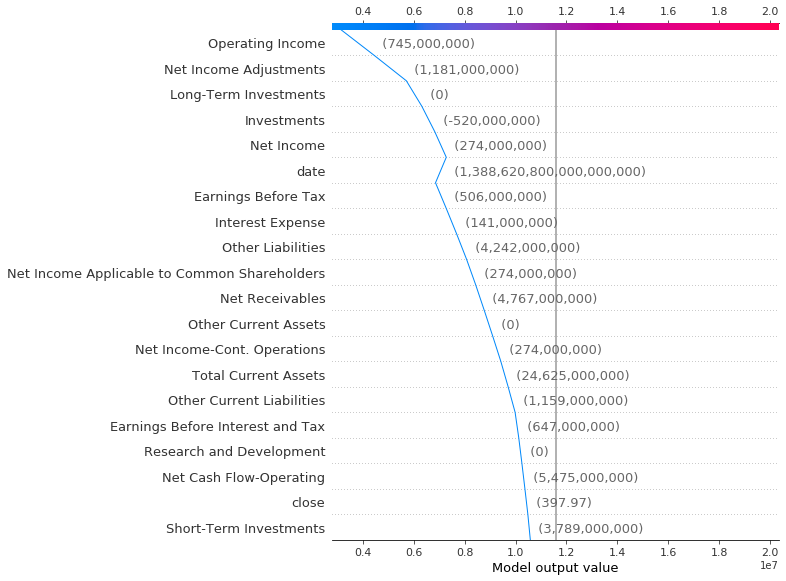

In [113]:
#AMZN
shap.decision_plot(explainer.expected_value, shap_values[10], applicant_profiler)

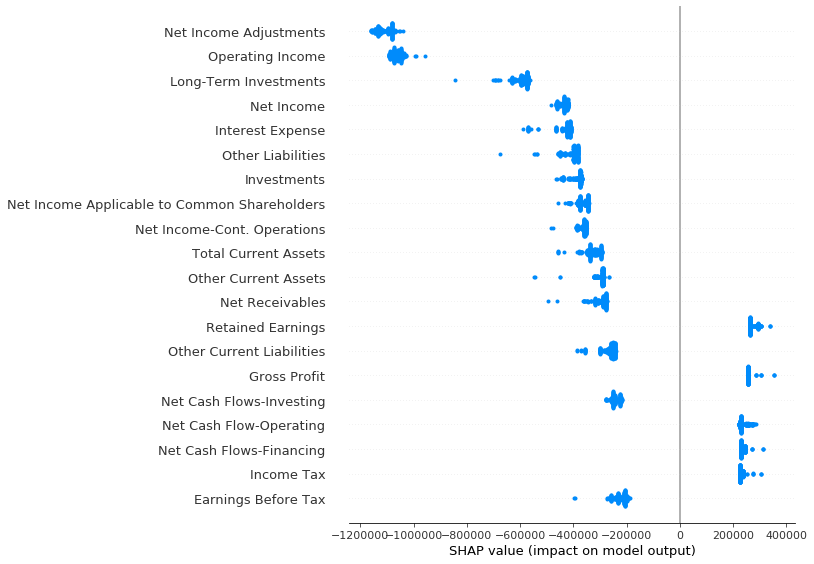

In [72]:
#Plot of Walmart volume
shap.summary_plot(shap_values, XT_val.columns)

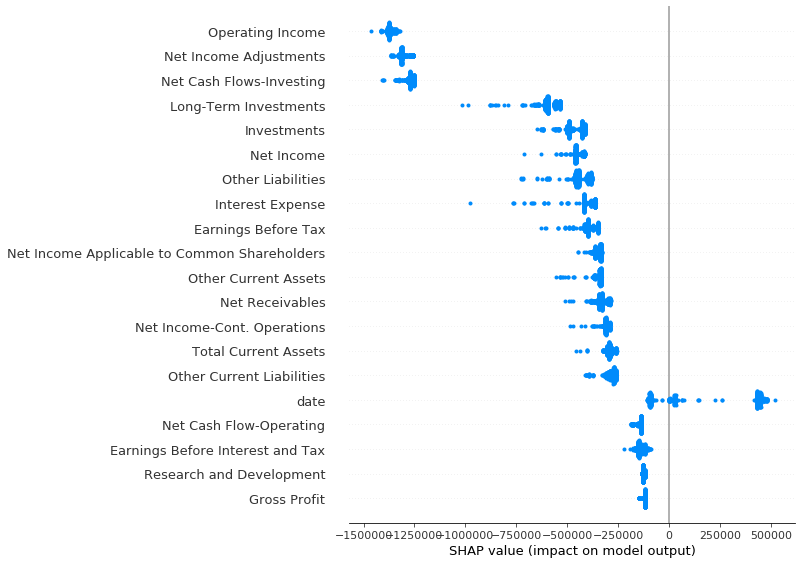

In [77]:
#Avb
shap.summary_plot(shap_values, XT_val.columns)

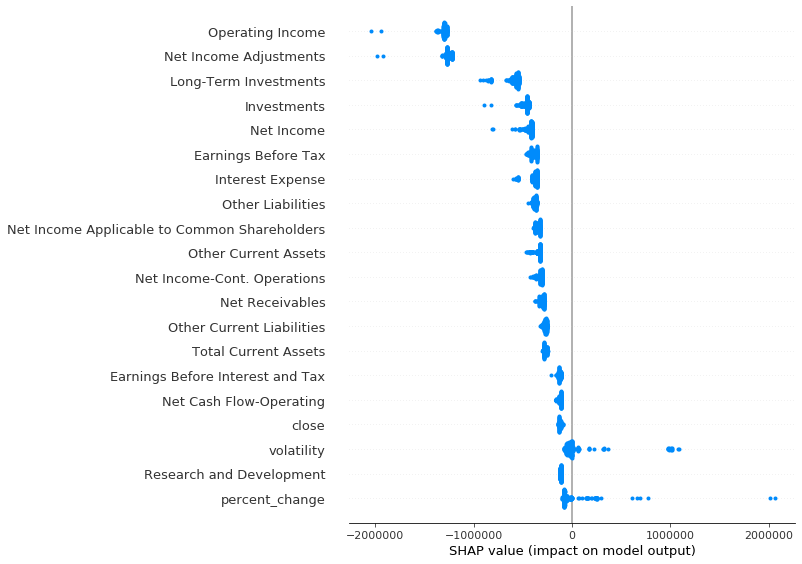

In [114]:
#Amzn
shap.summary_plot(shap_values, XT_val.columns)

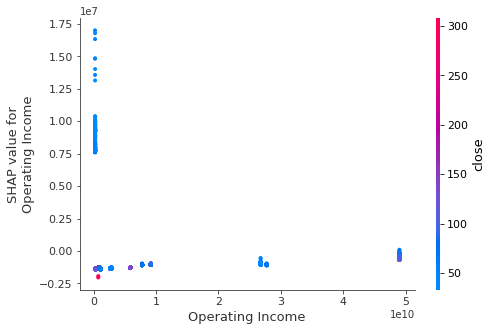

In [106]:
shap.dependence_plot('Operating Income', shap_values, applicant_profiler)

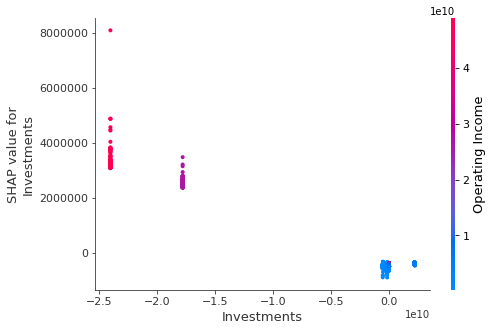

In [131]:
shap.dependence_plot('Investments', shap_values, applicant_profiler, interaction_index="Operating Income")

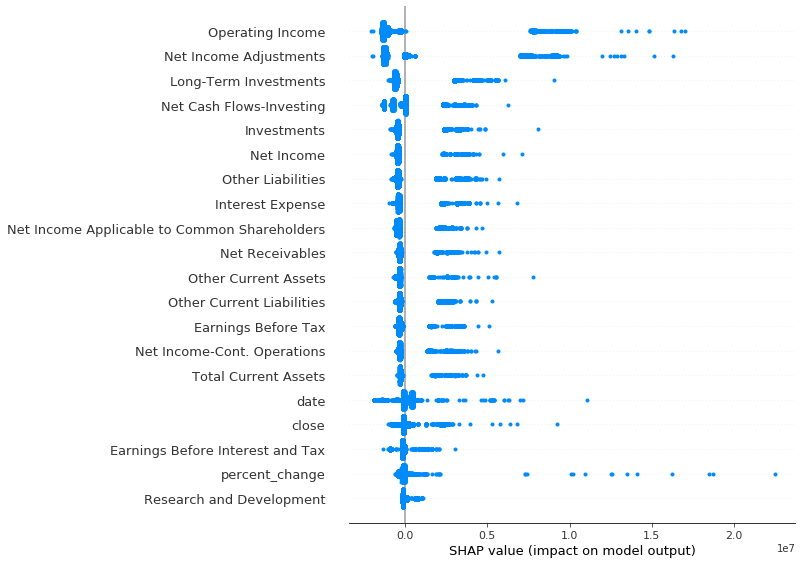

In [132]:
#Summary of everything
shap.summary_plot(shap_values, XT_val.columns)

In [145]:
target = 'close'
features = merged_df.columns.drop([target, 'returns', '5_day_MA', '10_day_MA', '20_day_MA', '40_day_MA'])

Index(['date', 'symbol', 'volume', 'year', 'month', 'day', 'GICS Sector',
       'GICS Sub Industry', 'Accounts Payable', 'Accounts Receivable',
       'Add'l income/expense items', 'After Tax ROE', 'Capital Expenditures',
       'Capital Surplus', 'Cash Ratio', 'Cash and Cash Equivalents',
       'Changes in Inventories', 'Common Stocks', 'Cost of Revenue',
       'Current Ratio', 'Deferred Asset Charges', 'Deferred Liability Charges',
       'Depreciation', 'Earnings Before Interest and Tax',
       'Earnings Before Tax', 'Effect of Exchange Rate',
       'Equity Earnings/Loss Unconsolidated Subsidiary', 'Fixed Assets',
       'Goodwill', 'Gross Margin', 'Gross Profit', 'Income Tax',
       'Intangible Assets', 'Interest Expense', 'Inventory', 'Investments',
       'Liabilities', 'Long-Term Debt', 'Long-Term Investments',
       'Minority Interest', 'Misc. Stocks', 'Net Borrowings', 'Net Cash Flow',
       'Net Cash Flow-Operating', 'Net Cash Flows-Financing',
       'Net Cash Flows-

In [146]:
#Close model with subsection
X_train, X_val, y_train, y_val, model = model_builder(df_subsection, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:    8.6s
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed:   15.0s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   

Baseline Accuracy: 0.001488095238095238
Training Score: 0.9897753894138235
Validation Score: 0.5036406983145919


In [562]:
y_pred = model.predict(X_train)
y_pred_val = model.predict(X_val)


print('Training mean_absolute_error:', mean_absolute_error(y_train, y_pred))
print('Training mean_squared_error:', mean_squared_error(y_train, y_pred))
print('Validation mean_absolute_error:', mean_absolute_error(y_val, y_pred_val))
print('Validation mean_squared_error:', mean_squared_error(y_val, y_pred_val))

Training mean_absolute_error: 15.039179108787685
Training mean_squared_error: 400.50267602068436
Validation mean_absolute_error: 31.53649910545631
Validation mean_squared_error: 3900.427007843355


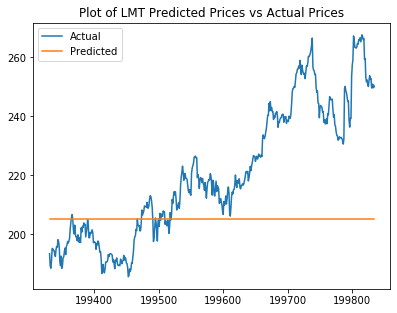

In [584]:
ticker = ['LMT']
X_val_stocks = X_val[X_val['symbol'].isin(ticker)]
y_val_stocks = y_val[y_val.index.isin(X_val_stocks.index)]

y_pred_val = model.predict(X_val)
y_pred_stocks = model.predict(X_val_stocks)

temp = y_val_stocks.to_frame(name='Actual')
temp['Predicted'] = y_pred_stocks

temp.plot(title=("Plot of " + ticker[0] + " Predicted Prices vs Actual Prices"))

In [579]:
y_pred_val = model.predict(X_val)
y_pred_stocks = model.predict(X_val_stocks)

temp = y_val_stocks.to_frame(name='Actual')
temp['Predicted'] = y_pred_stocks

temp.plot(title=("Plot of " + ticker[0] + " Predicted Prices vs Actual Prices"))

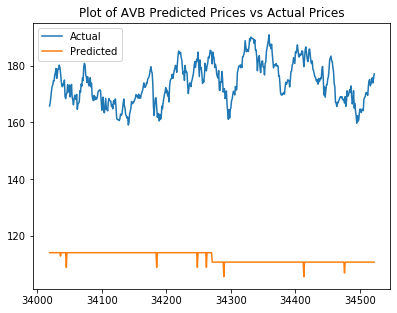

In [580]:
temp = y_val_stocks.to_frame(name='Actual')
temp['Predicted'] = y_pred_stocks

temp.plot(title=("Plot of " + ticker[0] + " Predicted Prices vs Actual Prices"))

In [147]:
XT_val = ce.BinaryEncoder().fit(X_train).transform(X_train)
XTT_val = SimpleImputer().fit(XT_val).transform(XT_val)
XTT_val = pd.DataFrame(XTT_val, columns = XT_val.columns, index=XT_val.index)

In [148]:
explainer = shap.TreeExplainer(model[2])
applicant_profiler = XTT_val
#applicant_profiler = XTT_val[XTT_val.index.isin(wmt_df.index)]
shap_values = explainer.shap_values(applicant_profiler)

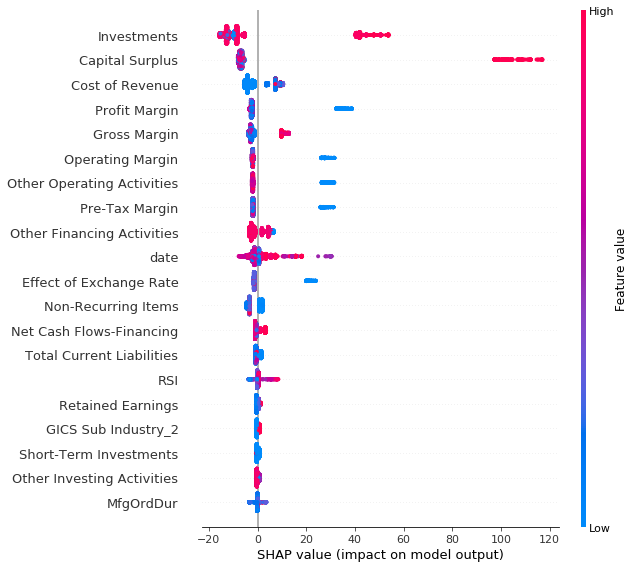

In [157]:
shap.summary_plot(shap_values, XTT_val)

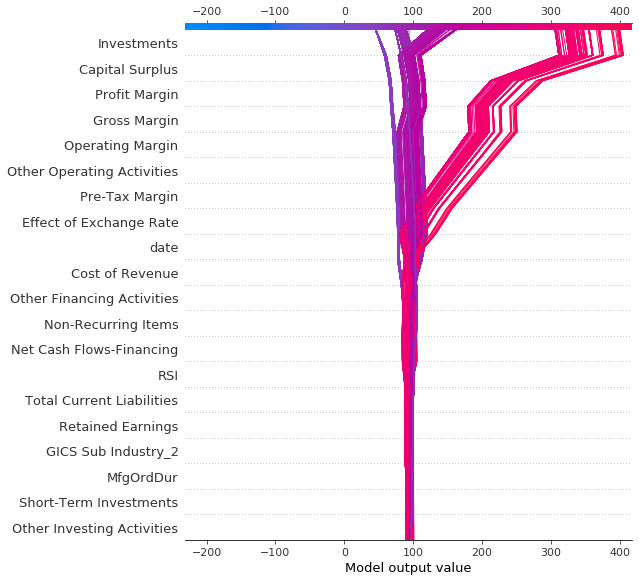

In [156]:
shap.decision_plot(explainer.expected_value, shap_values[0:2000], applicant_profiler)

In [179]:
def pred_ints(model, X, percentile=95):
    err_down = []
    err_up = []
    preds = model.predict(X)
    for x in range(len(X)):
        #err_down.append(np.percentile(preds, (100 - percentile) / 2. ))
        #err_up.append(np.percentile(preds, 100 - (100 - percentile) / 2.))
    #return err_down, err_up

In [181]:
#err_down, err_up = pred_ints(model[2], XTT_val, percentile=90)
pred_ints(model[2], XTT_val, percentile=90)
#truth = Y_val
#correct = 0.
#for i, val in enumerate(truth):
#    if err_down[i] <= val <= err_up[i]:
#        correct += 1
#print(correct/len(truth))

In [212]:
y_val = y_val[y_val.index.isin(X_val.index)]
len(y_val)

5796

In [213]:
ci = y_val.to_frame()
ci['pred'] = model.predict(X_val)
ci.head(3)

,close,pred
2519,109.33,86.872944
2520,106.25,86.872944
2521,106.26,86.872944


In [237]:
y_val = y_val[y_val.index.isin(X_val.index)]

ci = y_val.to_frame()
ci['pred'] = model.predict(X_val)

off = []
within_1 = []
within_5 = []
within_10 = []
within_50 = []
for col in ci.iterrows():
    a = 1.01
    b = .99
    percent = col[1][0] / col[1][1]
    off.append(percent)
    bool_within_1_percent = min(a, b) < percent < max(a, b)
    within_1.append(bool_within_1_percent)
    a = 1.05
    b = .95
    
    bool_within_5_percent = min(a, b) < percent < max(a, b)
    within_5.append(bool_within_5_percent)
    
    a = 1.1
    b = .9
    bool_within_10_percent = min(a, b) < percent < max(a, b)
    within_10.append(bool_within_10_percent)
    
    a = 1.5
    b = .5
    bool_within_50_percent = min(a, b) < percent < max(a, b)
    within_50.append(bool_within_50_percent)
    
    
ci['percent_off'] = off
ci['within 1% interval'] = within_1
ci['within 5% interval'] = within_5
ci['within 10% interval'] = within_10
ci['within 50% interval'] = within_50

ci['within 1% interval'].value_counts(normalize=True)

In [229]:
ci['within 1% interval'].value_counts(normalize=True)

False    0.986715
True     0.013285
Name: within 1% interval, dtype: float64

In [231]:
ci['within 5% interval'].value_counts(normalize=True)

False    0.944617
True     0.055383
Name: within 5% interval, dtype: float64

In [236]:
ci['within 10% interval'].value_counts(normalize=True)

False    0.875259
True     0.124741
Name: within 10% interval, dtype: float64

In [238]:
ci['within 50% interval'].value_counts(normalize=True)

True     0.706177
False    0.293823
Name: within 50% interval, dtype: float64

In [239]:
target = 'close'
features = merged_df.columns.drop([target, 'returns', '5_day_MA', '10_day_MA', '20_day_MA', '40_day_MA'])

In [240]:
#Closing prices model
X_train, X_val, y_train, y_val, model = model_builder(merged_df, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   26.2s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:   28.8s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:  5.2min
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:  7.4min
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:  8.2min
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed: 10.5min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed: 14.3min
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed: 15.9min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed: 19

Baseline Accuracy: 0.0002446592672156582
Training Score: 0.9310818293109653
Validation Score: 0.5699147695218785


In [563]:
y_pred = model.predict(X_train)
y_pred_val = model.predict(X_val)


print('Training mean_absolute_error:', mean_absolute_error(y_train, y_pred))
print('Training mean_squared_error:', mean_squared_error(y_train, y_pred))
print('Validation mean_absolute_error:', mean_absolute_error(y_val, y_pred_val))
print('Validation mean_squared_error:', mean_squared_error(y_val, y_pred_val))

Training mean_absolute_error: 15.039179108787685
Training mean_squared_error: 400.50267602068436
Validation mean_absolute_error: 31.53649910545631
Validation mean_squared_error: 3900.4270078433547


In [550]:
XT_val = ce.BinaryEncoder().fit(X_train).transform(X_train)
XTT_val = SimpleImputer().fit(XT_val).transform(XT_val)
XTT_val = pd.DataFrame(XTT_val, columns = XT_val.columns, index=XT_val.index)

In [551]:
explainer = shap.TreeExplainer(model[2])
applicant_profiler = XTT_val
#applicant_profiler = XTT_val[XTT_val.index.isin(wmt_df.index)]
shap_values = explainer.shap_values(applicant_profiler)

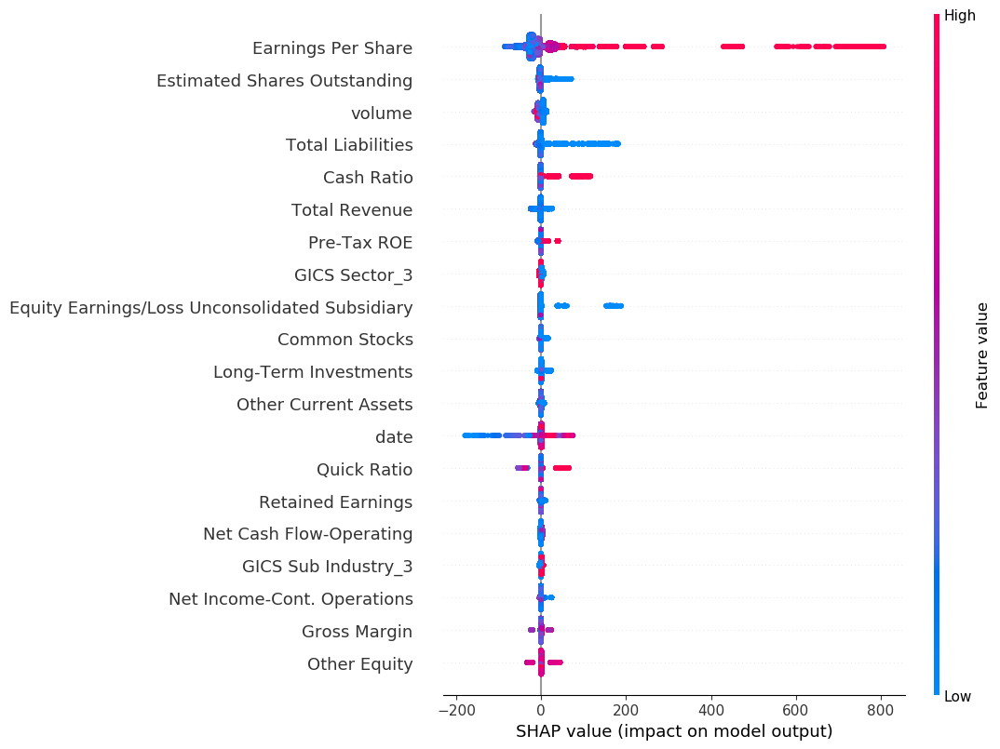

In [552]:
#Closing prices
shap.summary_plot(shap_values, XTT_val, sort=True)

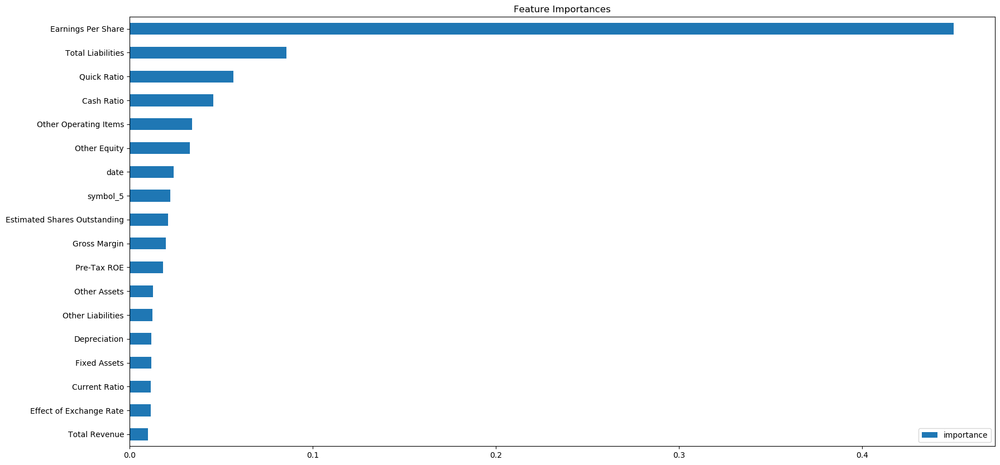

In [549]:
#Closing model
feature_importance = pd.DataFrame(model[2].feature_importances_, index = model[0].get_feature_names(), columns=['importance']).sort_values('importance', ascending=True)
feature_importance[feature_importance['importance'] > 0.01].plot.barh(figsize=(20,10), title='Feature Importances')

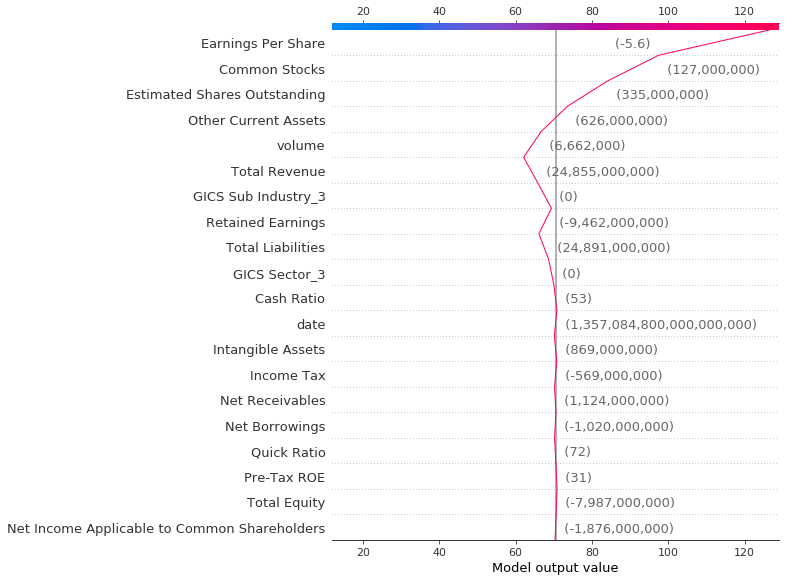

In [261]:
shap.decision_plot(explainer.expected_value, shap_values[1000], applicant_profiler)

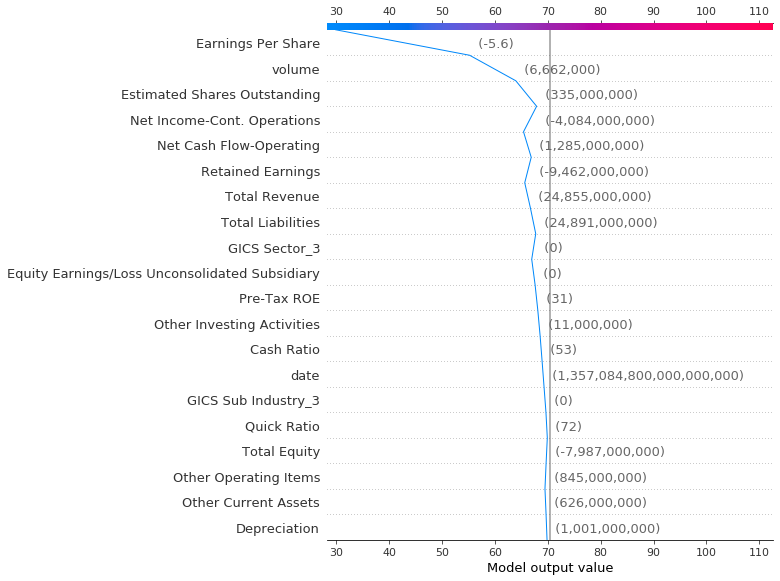

In [262]:
shap.decision_plot(explainer.expected_value, shap_values[100], applicant_profiler)

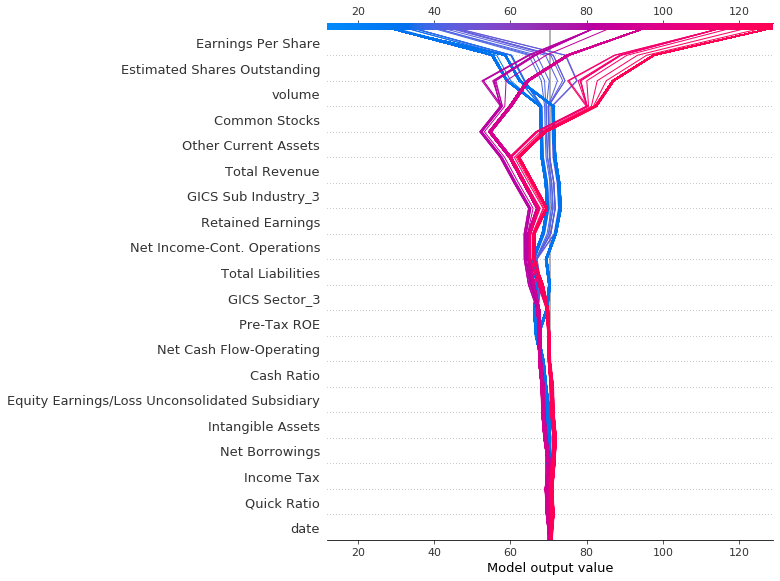

In [264]:
shap.decision_plot(explainer.expected_value, shap_values[0:1000], applicant_profiler)

In [271]:
y_val = y_val[y_val.index.isin(X_val.index)]

ci = y_val.to_frame()
ci['pred'] = model.predict(X_val)

off = []
within_1 = []
within_5 = []
within_10 = []
within_20 = []
within_30 = []
within_50 = []
for col in ci.iterrows():
    a = 1.01
    b = .99
    percent = col[1][0] / col[1][1]
    off.append(percent)
    bool_within_1_percent = min(a, b) < percent < max(a, b)
    within_1.append(bool_within_1_percent)
    a = 1.05
    b = .95
    
    bool_within_5_percent = min(a, b) < percent < max(a, b)
    within_5.append(bool_within_5_percent)
    
    a = 1.1
    b = .9
    bool_within_10_percent = min(a, b) < percent < max(a, b)
    within_10.append(bool_within_10_percent)
    
    a = 1.2
    b = .8
    bool_within_20_percent = min(a, b) < percent < max(a, b)
    within_20.append(bool_within_20_percent)
    
    a = 1.3
    b = .7
    bool_within_30_percent = min(a, b) < percent < max(a, b)
    within_30.append(bool_within_30_percent)
    
    a = 1.5
    b = .5
    bool_within_50_percent = min(a, b) < percent < max(a, b)
    within_50.append(bool_within_50_percent)
    
    
ci['percent_off'] = off
ci['within 1% interval'] = within_1
ci['within 5% interval'] = within_5
ci['within 10% interval'] = within_10
ci['within 20% interval'] = within_20
ci['within 30% interval'] = within_30
ci['within 50% interval'] = within_50

ci['within 1% interval'].value_counts(normalize=True)

False    0.981246
True     0.018754
Name: within 1% interval, dtype: float64

In [272]:
ci['within 30% interval'].value_counts(normalize=True)

True     0.50856
False    0.49144
Name: within 30% interval, dtype: float64

In [273]:
target = 'returns'
features = merged_df.columns.drop([target, 'close'])

In [274]:
#Returns model
X_train2, X_val2, y_train2, y_val2, model2 = model_builder(merged_df, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   29.4s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:   33.7s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:  8.4min
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:  9.2min
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed: 11.8min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed: 16.4min
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed: 18.4min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed: 22

Baseline Accuracy: 0.002625611648168039
Training Score: 0.21107110726065803
Validation Score: -0.2637165217529289


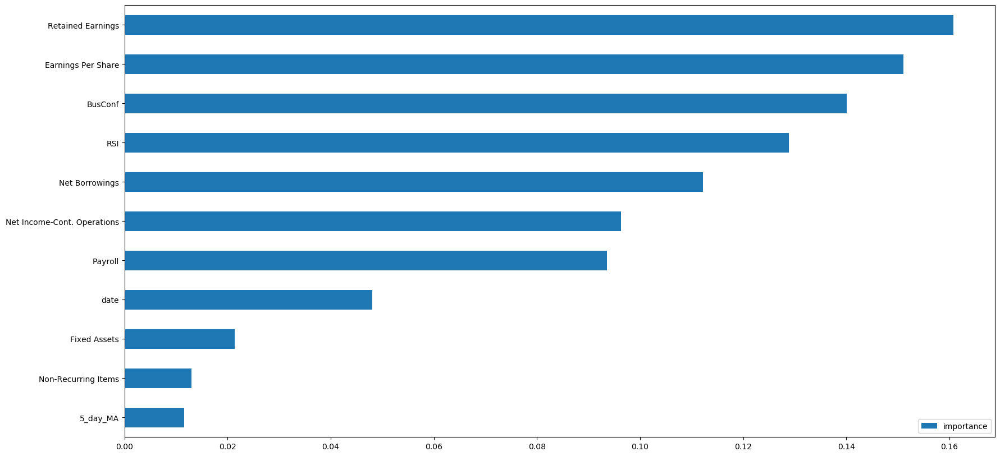

In [547]:
#Returns Model
feature_importance = pd.DataFrame(model2[2].feature_importances_, index = model2[0].get_feature_names(), columns=['importance']).sort_values('importance', ascending=True)
feature_importance[feature_importance['importance'] > 0.01].plot.barh(figsize=(20,10))

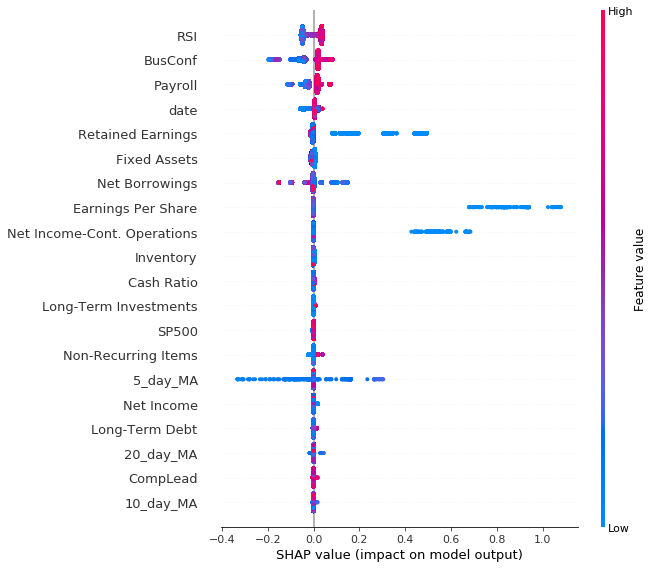

In [277]:
XT_val = ce.BinaryEncoder().fit(X_train2).transform(X_train2)
XTT_val = SimpleImputer().fit(XT_val).transform(XT_val)
XTT_val = pd.DataFrame(XTT_val, columns = XT_val.columns, index=XT_val.index)

explainer = shap.TreeExplainer(model2[2])
applicant_profiler = XTT_val
#applicant_profiler = XTT_val[XTT_val.index.isin(wmt_df.index)]
shap_values = explainer.shap_values(applicant_profiler)


shap.summary_plot(shap_values, XTT_val)

In [299]:
returns_table = merged_df.pivot_table(index='date', columns='symbol', values='returns')

In [346]:
returns_table.index = pd.to_datetime(returns_table.index)

In [338]:
import datetime as dt

In [619]:
def plot_target_feature(df, returns_table, feature, count=8):
    returns_table = returns_table.copy()
    #returns_table = returns_table[returns_table.index.year >= dt.date(2014, 1, 1).year]
    feature_df = df[['date', 'year', 'symbol', 'returns', feature]]
    #feature_df = df.sort_values(by=feature).drop_duplicates()
    feature_df = feature_df.groupby(by='symbol').mean().sort_values(by=feature).dropna()
    #feature_df['date'] = pd.to_datetime(feature_df['date'])
    #feature_df = feature_df[feature_df['year'] => dt.date(2014, 1, 1).year]
    
    feature_lowest = feature_df.head(count)
    feature_highest = feature_df.tail(count)
    
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 10))

    highest_symbols = feature_highest.index
    lowest_symbols = feature_lowest.index
    
    for symbol in highest_symbols:
        returns = df[df['symbol'] == symbol][['date','returns']]
        returns['date'] = pd.to_datetime(returns['date'])
        returns = returns.set_index(['date'])
        ax[0].plot(returns)

    ax[0].set_xlabel("Date")
    ax[0].set_ylabel("Growth of $1 investment")
    ax[0].set_title(("Performance of Highest " + str(count) + " " + feature.title() + " Companies"))
    
    ax[0].legend(highest_symbols[:20])
    
    for symbol in lowest_symbols:
        returns = df[df['symbol'] == symbol][['date','returns']]
        
        returns['date'] = pd.to_datetime(returns['date'])
        returns = returns.set_index(['date'])
        ax[1].plot(returns)
    
    ax[1].set_xlabel("Date")
    ax[1].set_ylabel("Growth of $1 investment")
    ax[1].set_title(("Performance of Lowest " + str(count) + " " + feature.title() + " Companies"))

    ax[1].legend(lowest_symbols[:20])
    fig.tight_layout()
    plt.show()
    
    ###
    fig, ax = plt.subplots(figsize=(30, 10))
    
    highest = returns_table[highest_symbols].mean(axis=1)
    lowest = returns_table[lowest_symbols].mean(axis=1)
    high_min = highest.min()
    high_max = highest.max()
    low_min = lowest.min()
    low_max = lowest.max()
    
    min_lim = min(min(high_min, high_max), min(low_min, low_max)) - .1
    max_lim = max(max(high_min, high_max), max(low_min, low_max)) + .1
    ax.set_ylim([min_lim,max_lim])
    ax.plot(highest)
    
    textsize = 18
    
    ax.set_xlabel("Date", fontsize=textsize)
    ax.set_ylabel("Growth of $1 investment", fontsize=textsize)
    ax.set_title(("Performance of ".title() + str(count*2) + " Companies Sorted By Highest/Lowest ".title()  + feature.title()), fontsize=textsize+2)
    #ax[0].legend(highest_symbols)
    
    
    ax.plot(lowest)
    ax.legend([('Highest ' + feature.title()), ('Lowest ' + feature.title())], fontsize=textsize)
    plt.xticks(fontsize=textsize)
    plt.yticks(fontsize=textsize)
    fig.tight_layout()
    
    plt.show()
    

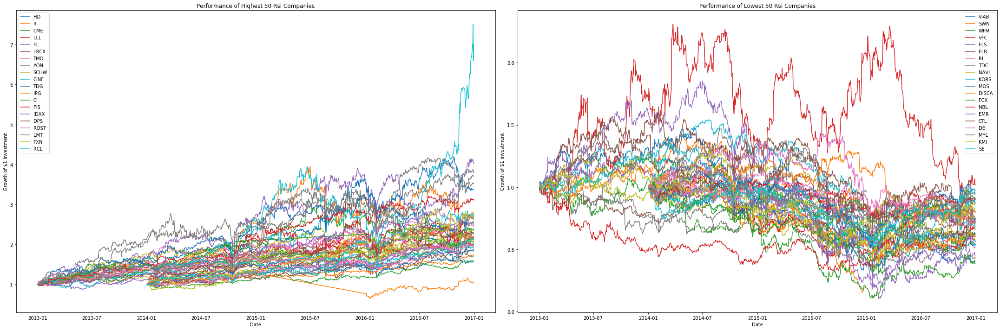

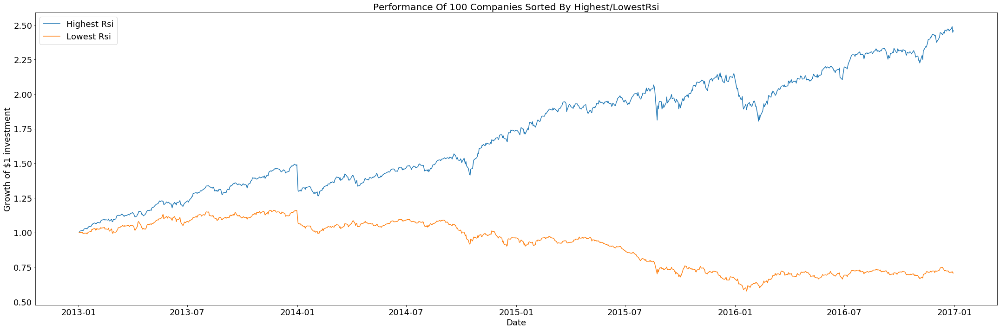

In [618]:
plot_target_feature(merged_df, returns_table, 'RSI', count=50)

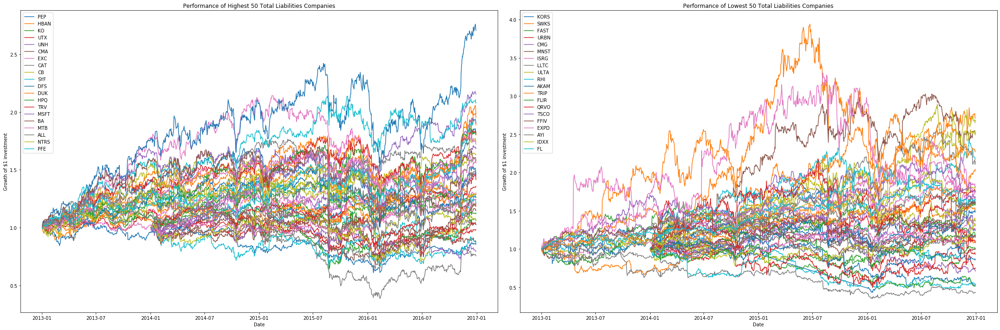

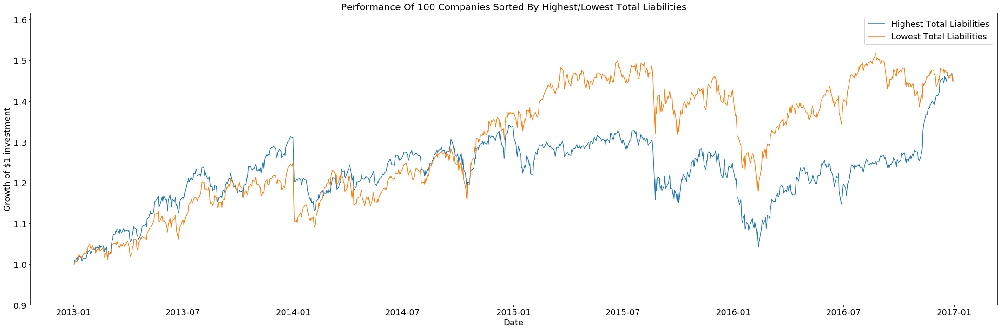

In [620]:
plot_target_feature(merged_df, returns_table, 'Total Liabilities', count=50)

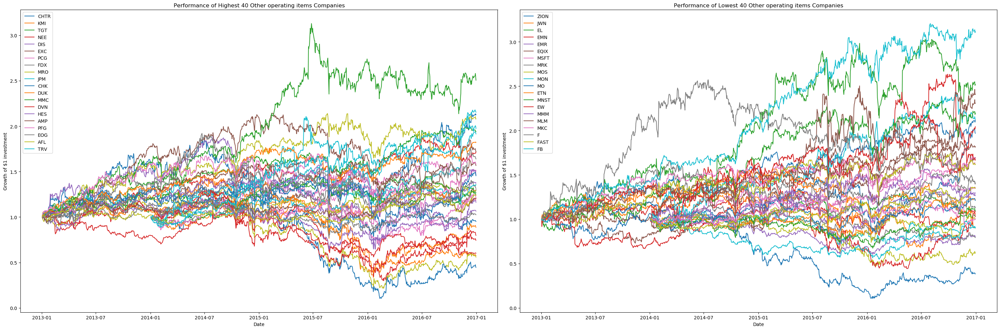

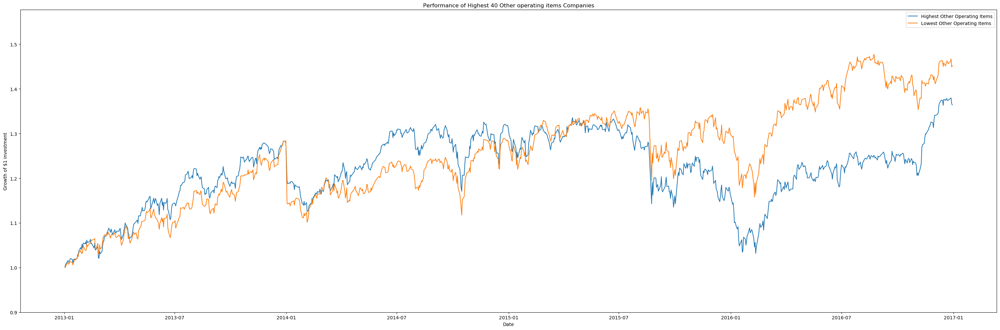

In [560]:
plot_target_feature(merged_df, returns_table, 'Other Operating Items', count=40)

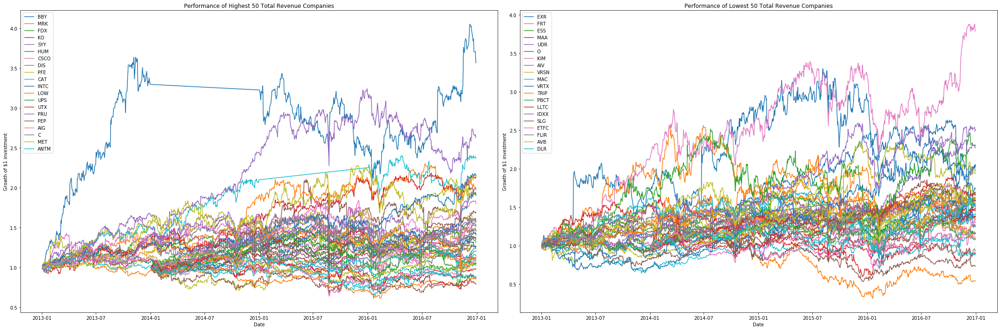

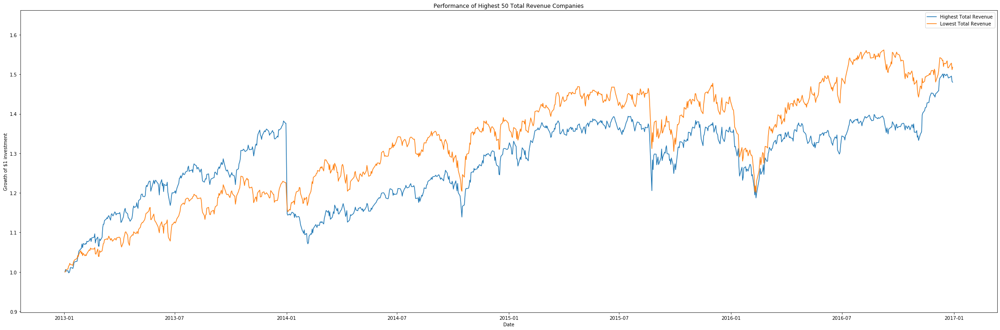

In [596]:
plot_target_feature(merged_df, returns_table, 'Total Revenue', count=50)

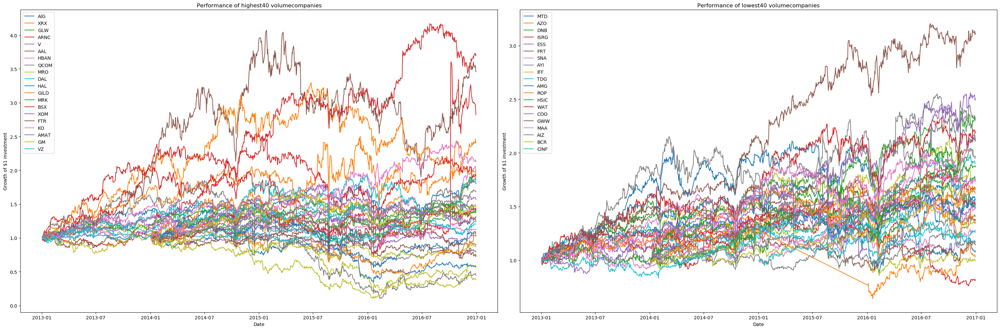

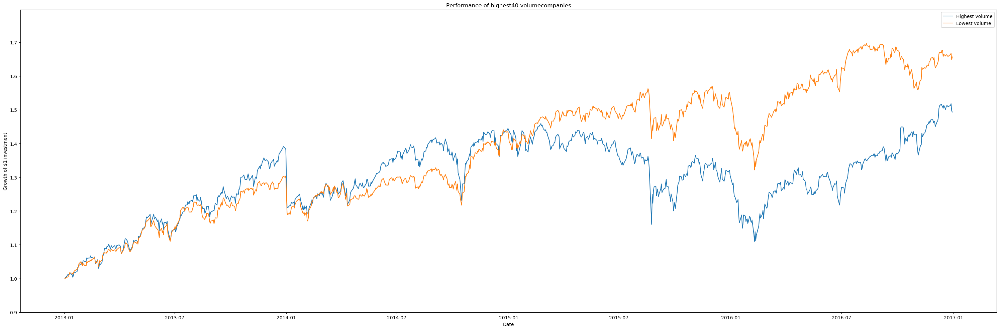

In [555]:
plot_target_feature(merged_df, returns_table, 'volume', count=40)

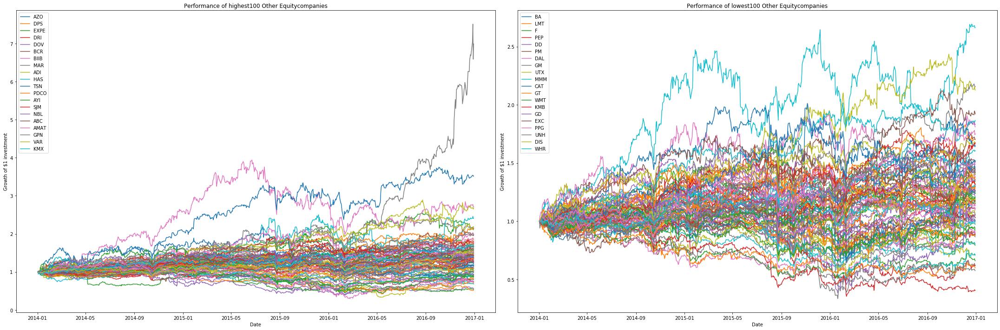

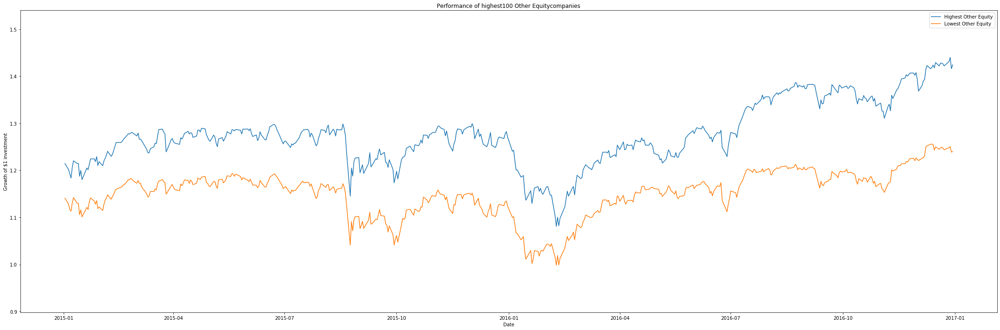

In [430]:
plot_target_feature(merged_df, returns_table, 'Other Equity', count=100)

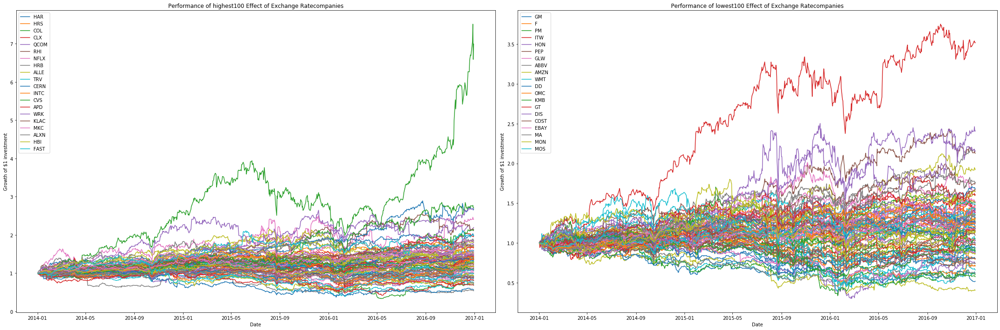

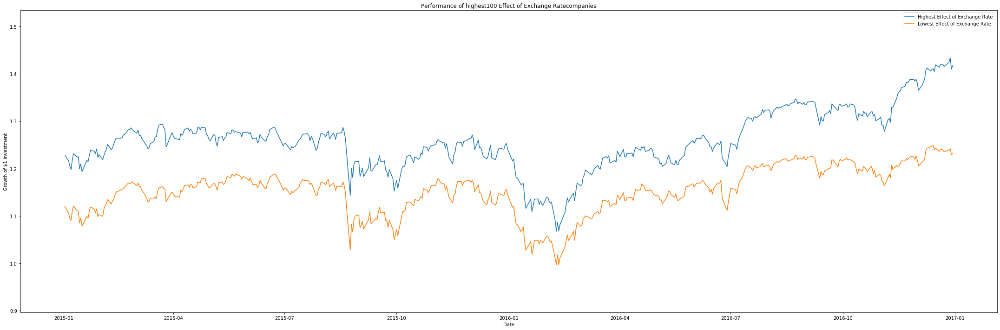

In [429]:
plot_target_feature(merged_df, returns_table, 'Effect of Exchange Rate', count=100)

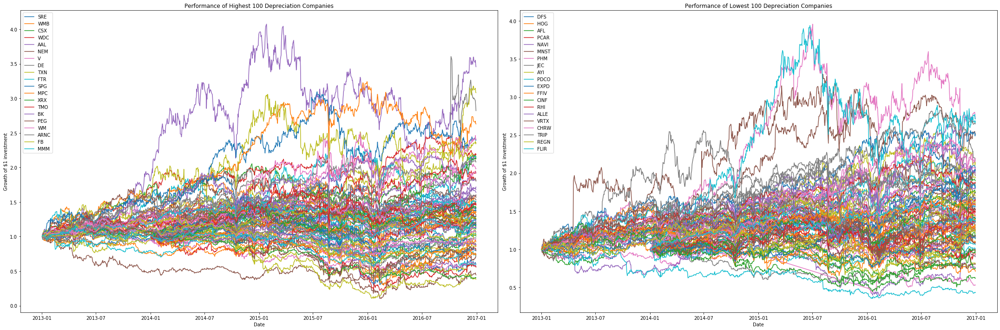

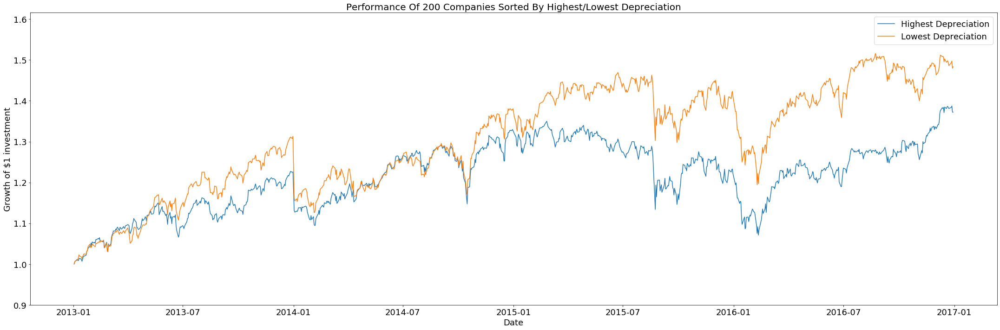

In [622]:
plot_target_feature(merged_df, returns_table, 'Depreciation', count=100)

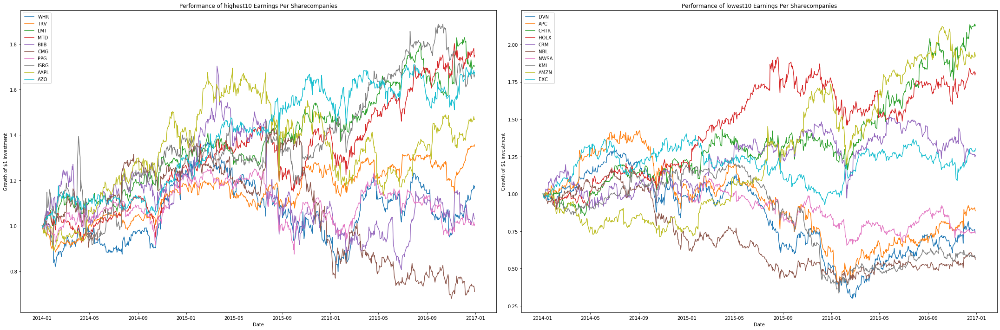

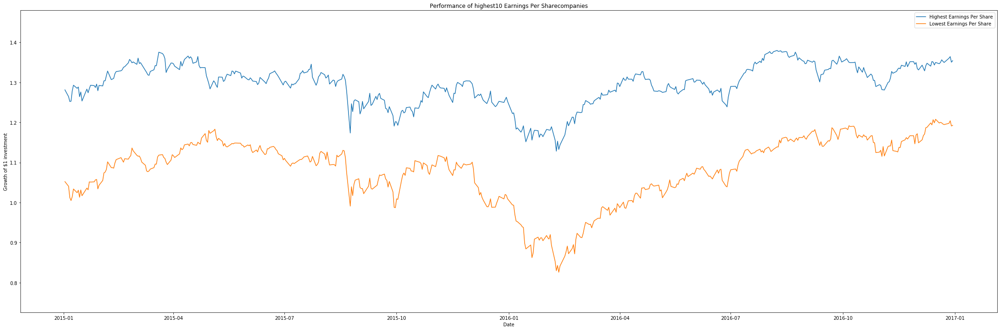

In [427]:
plot_target_feature(merged_df, returns_table, 'Earnings Per Share', count=10)

In [441]:
merged_df['symbol'].nunique()

436

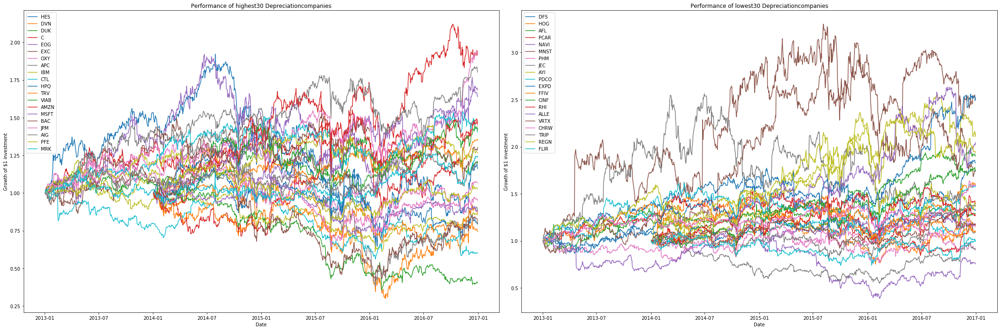

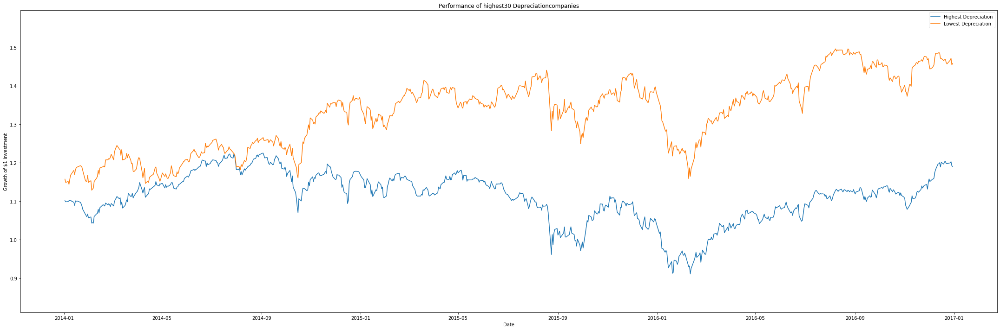

In [446]:
#According to model, not significant?
plot_target_feature(merged_df, returns_table, 'Depreciation', count=30)

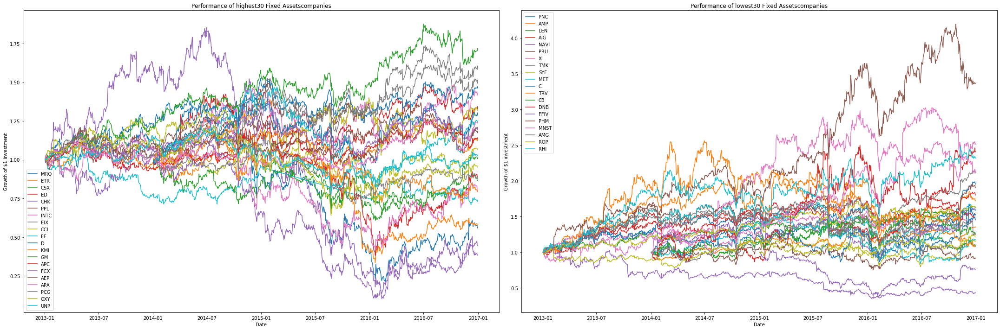

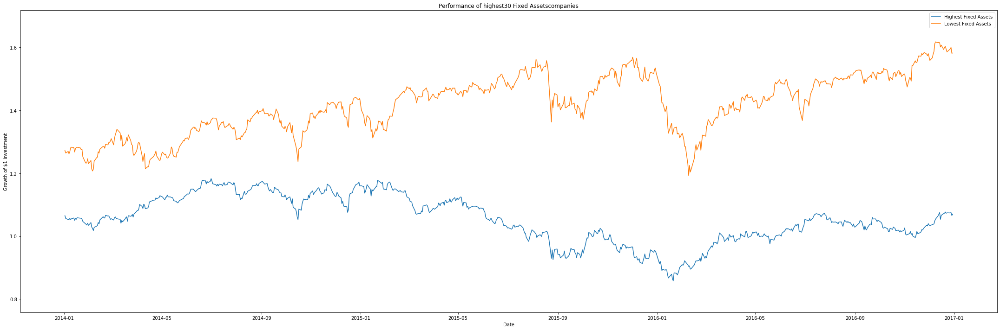

In [447]:
#Small importance
plot_target_feature(merged_df, returns_table, 'Fixed Assets', count=30)

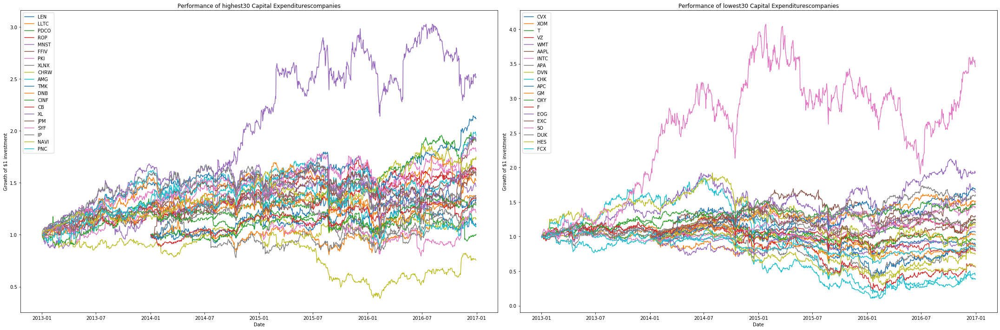

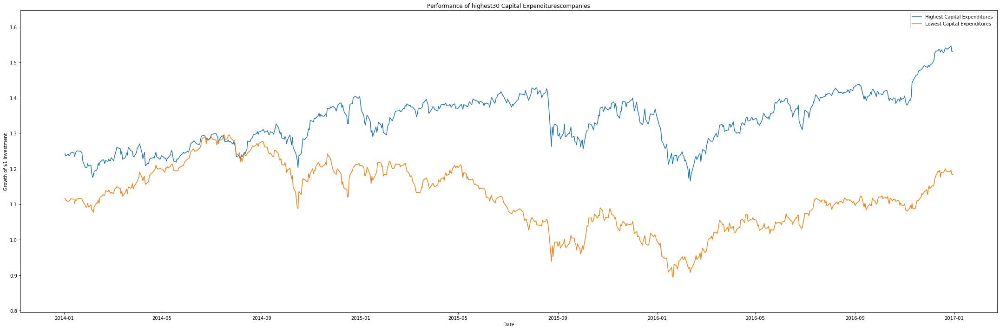

In [448]:
plot_target_feature(merged_df, returns_table, 'Capital Expenditures', count=30)

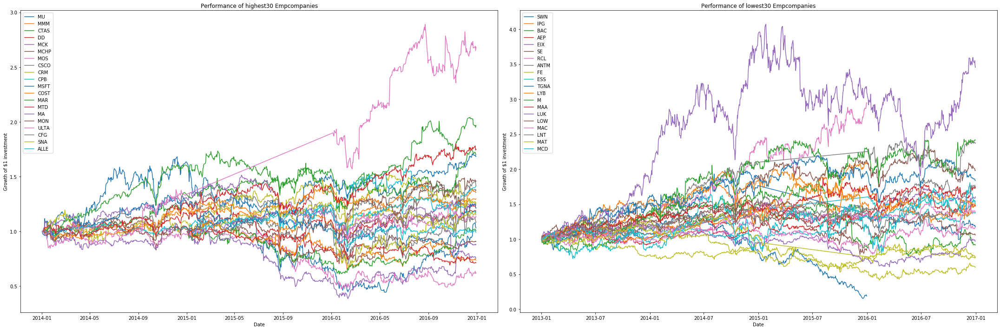

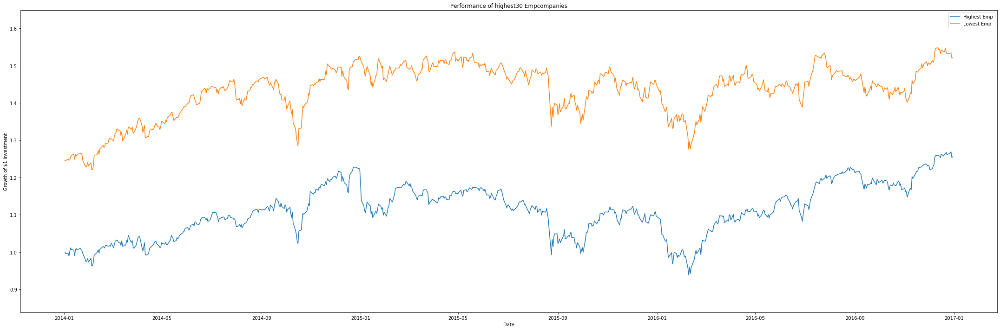

In [451]:
plot_target_feature(merged_df, returns_table, 'Emp', count=30)

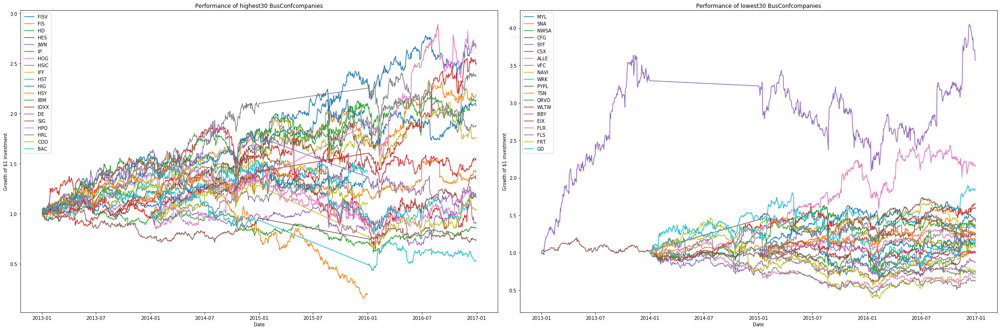

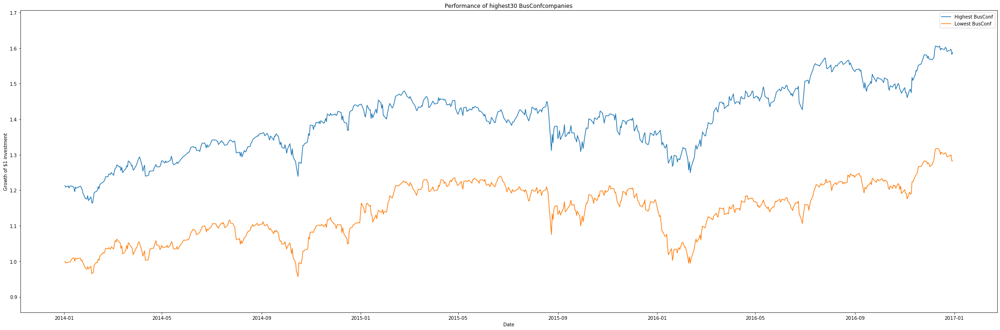

In [453]:
plot_target_feature(merged_df, returns_table, 'BusConf', count=30)

In [455]:
from sklearn import tree

[]

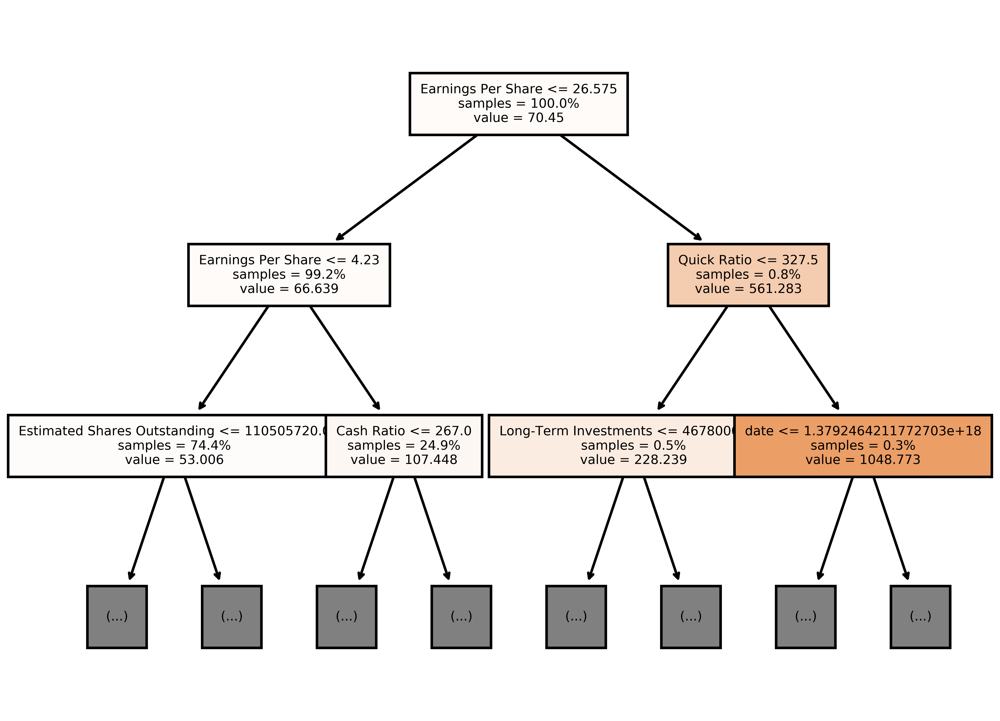

In [514]:
fig, axes = plt.subplots(dpi=1000)
plt.style.use('default')
tree.plot_tree(model[2].estimators_[0],
                     feature_names = XTT_val.columns, 
                     filled = True,
                     ax=axes,
                     max_depth=2,
                     fontsize=5,
              impurity=False,
               proportion=True)

plt.plot()


In [544]:
target = 'close'
features = merged_df.columns.drop([target, 'returns', '5_day_MA', '10_day_MA', '20_day_MA'])

In [545]:
#Closing prices with moving averages included
X_train3, X_val3, y_train3, y_val3, model3 = model_builder(merged_df, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   13.0s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   28.2s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:   33.2s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:  5.4min
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:  8.5min
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed: 10.8min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed: 14.3min
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed: 15.8min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed: 19

Baseline Accuracy: 0.0002446592672156582
Training Score: 0.9995049302896186
Validation Score: 0.989627831244982


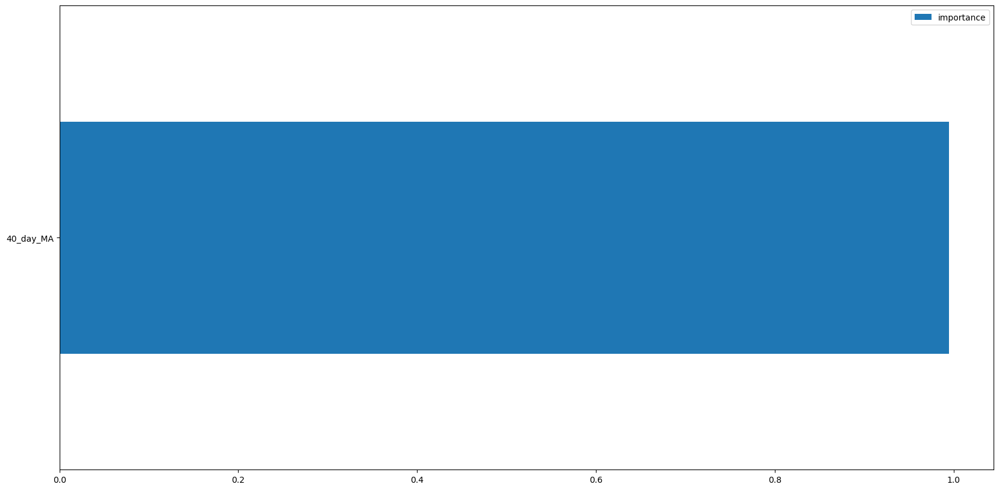

In [546]:
feature_importance = pd.DataFrame(model3[2].feature_importances_, index = model3[0].get_feature_names(), columns=['importance']).sort_values('importance', ascending=True)
feature_importance[feature_importance['importance'] > 0.01].plot.barh(figsize=(20,10))

In [553]:
len(merged_df.columns)

106

In [586]:
target = 'volume'
features = merged_df.columns.drop(target)
features

Index(['date', 'symbol', 'close', 'year', 'month', 'day', 'GICS Sector',
       'GICS Sub Industry', 'Accounts Payable', 'Accounts Receivable',
       ...
       'Payroll', 'PersCons', 'percent_change', 'returns', 'volatility',
       '5_day_MA', '10_day_MA', '20_day_MA', '40_day_MA', 'RSI'],
      dtype='object', length=105)

In [587]:
X_train4, X_val4, y_train4, y_val4, model4 = model_builder(merged_df, target, features)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   13.3s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   28.8s
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:   32.1s
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done  45 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done  69 tasks      | elapsed:  3.7min
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:  5.6min
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:  8.2min
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:  9.0min
[Parallel(n_jobs=-1)]: Done 129 tasks      | elapsed: 11.7min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed: 15.9min
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed: 18.1min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed: 22

Baseline Accuracy: 0.00011337868480725624
Training Score: 0.6850474538477741
Validation Score: 0.4988938920703457


In [693]:
from sklearn.linear_model import Ridge
from sklearn.feature_selection import SelectKBest
#Model features a one-hot-encoder, Select K Best, and ridge regression
def model_ridge_regression(df, target, features_arr):
  X = df[features_arr]
  y = df[target]

  temp = pd.to_datetime(df['date'])
  mask = temp <= dt.datetime(2015,1,1)
  mask_not = ~mask

  X_train = X[mask]
  y_train = y[mask]

  X_val = X[mask_not]
  y_val = y[mask_not]

  num = round(len(features)/2)

  model = make_pipeline(
      ce.BinaryEncoder(),
      SimpleImputer(),
      Ridge(alpha=0.2, copy_X=True, fit_intercept=True, max_iter=None, normalize=False, random_state=None, solver='auto', tol=0.001)
  )

  model.fit(X_train, y_train)

  #Training predictions derived from feature data
  y_pred_train = model.predict(X_train)

  #Validation predictions derived from feature data
  y_pred = model.predict(X_val)

  #Get mean absolute error for the test set.
  print("Training Mean absolute error:", mean_absolute_error(y_train, y_pred_train))
  print("Validation Mean absolute error:", mean_absolute_error(y_val, y_pred), '\n')

  print('Training MAE:', mean_absolute_error(y_train, y_pred_train))
  print('Validation MAE:', mean_absolute_error(y_val, y_pred), '\n')

  print("Traning RMSE:", mean_squared_error(y_train, y_pred_train, squared=False))
  print("Validation RMSE:", mean_squared_error(y_val, y_pred, squared=False), '\n')

  print("Training R-squared score is:", model.score(X_train, y_train))
  print("Validation R-squared is:", model.score(X_val, y_val), '\n')

  fig, ax = plt.subplots(figsize=(10,5))
    
  textsize = 16

  ax.set_xlabel(features_arr[0].title(), fontsize=textsize)
  ax.set_ylabel('Closing Price'.title(), fontsize=textsize)
  ax.set_title(("Ridge Regression Line"), fontsize=textsize+2)

  plt.xticks(fontsize=textsize)
  plt.yticks(fontsize=textsize)
  fig.tight_layout()

  ax.scatter(X_val, y_val)
  ax.plot(X_val, y_pred, color='red')
  plt.plot()

In [674]:
target = 'close'
features = ['Depreciation']

Training Mean absolute error: 36.875739433556646
Validation Mean absolute error: 43.23079323843968 

Training MAE: 36.875739433556646
Validation MAE: 43.23079323843968 

Traning RMSE: 76.18933955915435
Validation RMSE: 96.07852188433279 

Training R-squared score is: 0.0011121352919154504
Validation R-squared is: -0.017876293953412725 



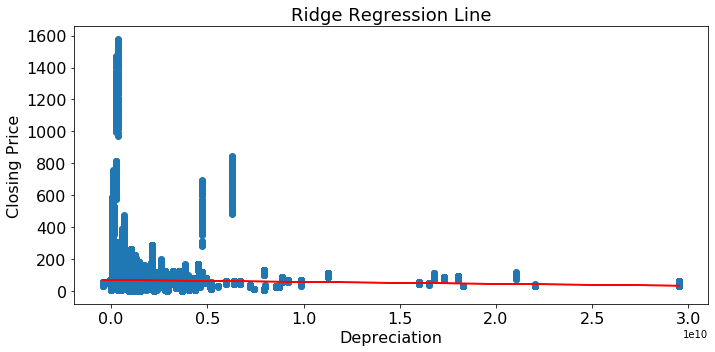

In [697]:
target = 'close'
features = ['Depreciation']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 36.768276011427496
Validation Mean absolute error: 43.282961752765196 

Training MAE: 36.768276011427496
Validation MAE: 43.282961752765196 

Traning RMSE: 76.11399502851498
Validation RMSE: 96.00678858170035 

Training R-squared score is: 0.0030867822609148554
Validation R-squared is: -0.01635694561912615 



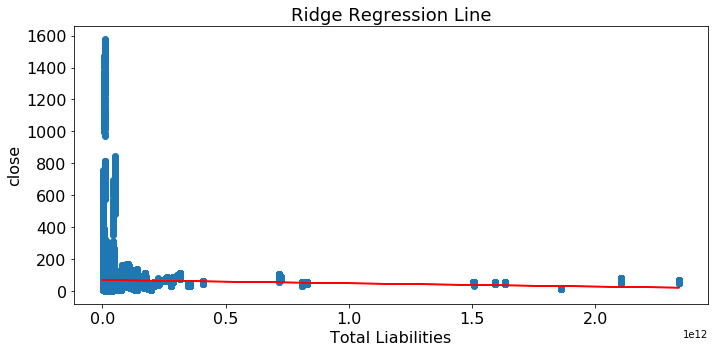

In [678]:
target = 'close'
features = ['Total Liabilities']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 30.03048593589187
Validation Mean absolute error: 38.84344058788876 

Training MAE: 30.03048593589187
Validation MAE: 38.84344058788876 

Traning RMSE: 60.47608150190348
Validation RMSE: 80.62277776370092 

Training R-squared score is: 0.37064511657853594
Validation R-squared is: 0.2832661957773466 



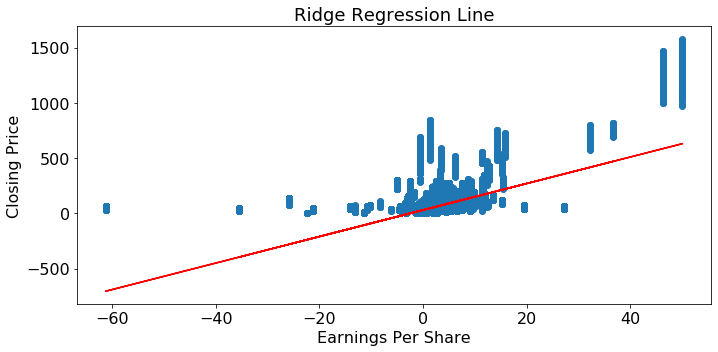

In [696]:
target = 'close'
features = ['Earnings Per Share']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 36.29269851981388
Validation Mean absolute error: 49.92329500871028 

Training MAE: 36.29269851981388
Validation MAE: 49.92329500871028 

Traning RMSE: 75.78723502321081
Validation RMSE: 95.67670070773694 

Training R-squared score is: 0.011627974646517547
Validation R-squared is: -0.009380139560001721 



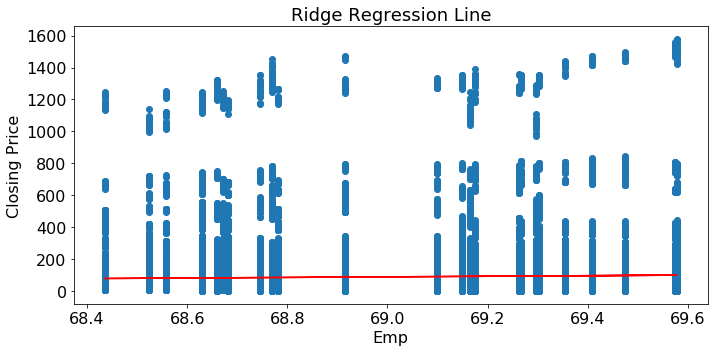

In [695]:
target = 'close'
features = ['Emp']

model_ridge_regression(merged_df, target, features)

In [668]:
df_econ.columns

Index(['Period', 'ConsConf', 'CompLead', 'BusConf', 'Emp', 'InvToSales', 'PMI',
       'SP500', 'MfgOrdDur', 'BldgPerm', 'Sales', 'FedFunds', 'DJI', 'Payroll',
       'PersCons'],
      dtype='object')

Training Mean absolute error: 0.10941298799945502
Validation Mean absolute error: 0.5184778384697684 

Training MAE: 0.10941298799945502
Validation MAE: 0.5184778384697684 

Traning RMSE: 0.1684585386639311
Validation RMSE: 0.6126495829192355 

Training R-squared score is: 0.8613680405113197
Validation R-squared is: -2.0422951225673733 



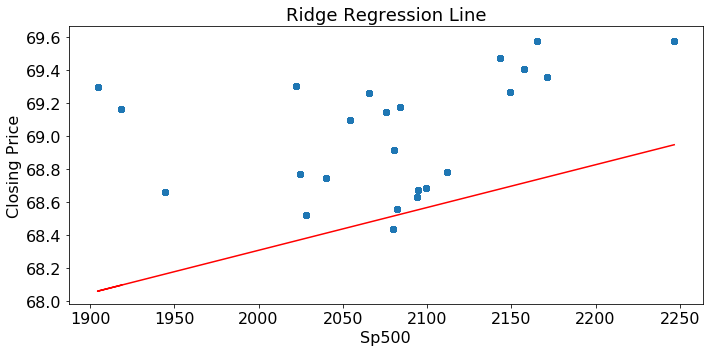

In [725]:
target = 'Emp'
features = ['SP500']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 36.450845239672674
Validation Mean absolute error: 50.89215160915516 

Training MAE: 36.450845239672674
Validation MAE: 50.89215160915516 

Traning RMSE: 75.93849849553338
Validation RMSE: 96.05451410542629 

Training R-squared score is: 0.007678660958286065
Validation R-squared is: -0.01736767047693233 



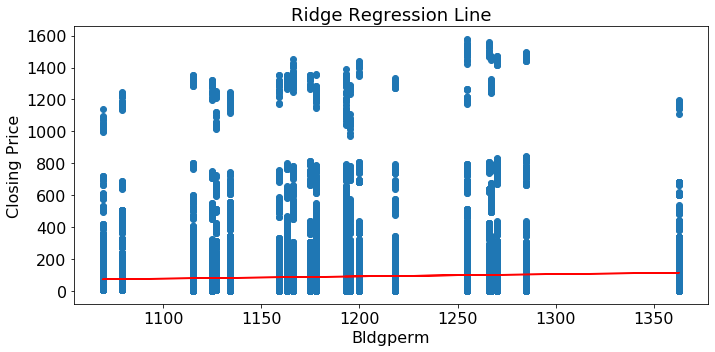

In [694]:
target = 'close'
features = ['BldgPerm']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 3.556993909761982
Validation Mean absolute error: 2.557273608590676 

Training MAE: 3.556993909761982
Validation MAE: 2.557273608590676 

Traning RMSE: 14.220596129210572
Validation RMSE: 5.371294252394181 

Training R-squared score is: 0.9652012275630368
Validation R-squared is: 0.9968187319543764 



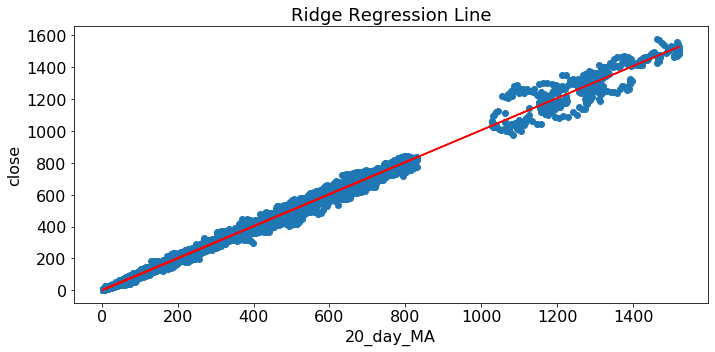

In [679]:
target = 'close'
features = ['20_day_MA']

model_ridge_regression(merged_df, target, features)

Training Mean absolute error: 5.942787521269246
Validation Mean absolute error: 3.626818832570873 

Training MAE: 5.942787521269246
Validation MAE: 3.626818832570873 

Traning RMSE: 20.553695617104083
Validation RMSE: 7.255210394733719 

Training R-squared score is: 0.9273043941193019
Validation R-squared is: 0.9941957996373432 



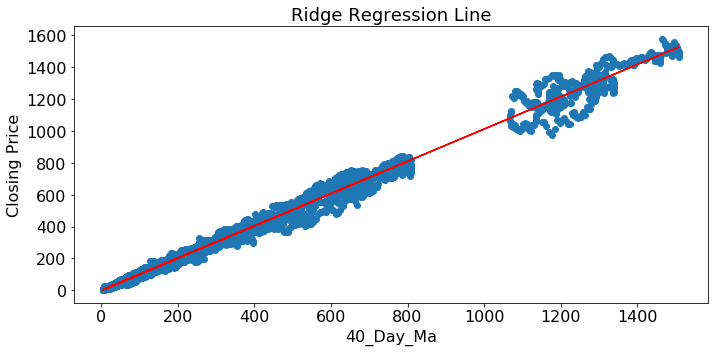

In [726]:
target = 'close'
features = ['40_day_MA']

model_ridge_regression(merged_df, target, features)